# Background

## Introduction/Business Problem

I live in San Diego, CA, one of the top ten most populous US cities with roughly 1.5 million people.  Due to its Spanish and Mexican historical roots and proximity to the US/Mexico border, there is a large Latino population in the city, predominantly from our neighbor Mexico.  In addition to residents, a large number of workers cross over from Tijuana and back each day to work jobs in the US, and often need somewhere to grab lunch. Anywhere you drive around there seems to be an abundance of Mexican eateries, many of which are family-owned and well-known to San Diegans. However, it still seems there are go-to neighborhoods around the city that are known for having the best Mexican food, and some neighborhoods with little to no options.  With this project I will explore, for a budding entrepreneur who cooks the best Mexican food in the neighborhood, where the optimal location would be to open a new enterprise in a seemingly-saturated marketplace with such a large total addressable market.

Using geospatial and demographic data. I will explore neighborhoods in the city of San Diego, cluster them and determine identifying demographic characteristics of each.  Then using venue data from the Foursquare API, I will identify underserved communities for a new Mexican food restaurant based on various factors, and provide recommendations for different strategic options.

## Data Sources and Use

Using the City of San Diego's Data Portal (https://data.sandiegocounty.gov/browse), I identified several datasets containing different demographic data points such as '2017 San Diego County Demographics - Race and Ethnicity', '2016 San Diego County Demographics - Age and Gender' and '2016 San Diego County Demographic Profiles - Median Income and Persons Per Household'. These datasets contain various demographic data broken down by neighborhood.  'Neighborhood' refers to census-designated Subregional Areas (SRAs), which have remained consistent for many years.  Geospatial data for San Diego SRAs came from San Diego ArcGIS dataset MSA_SRA (https://sdgis-sandag.opendata.arcgis.com/datasets/msa-sra), with help from the online virtual mapping application.  GeoJSON came from (https://sdgis-sandag.opendata.arcgis.com/datasets/subregional-areas-sras/geoservice) for polygon outlines of neighborhoods. Venue data was obtained using the Foursquare API.

In [1]:
# import all dependencies

import pandas as pd
import numpy as np
import re
import requests
import os

import fnmatch

import json
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

from geopy.geocoders import Nominatim #convert address into geographic coordinates

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
import seaborn as sns

from sklearn.cluster import KMeans

import folium

# Methodology

### Segment neighborhoods, create clusters from venue data

Using the San Diego ArcGIS mapping tool, I pulled the geospacial data for each of the San Diego neighborhoods and saved them to a local csv dataset.

In [2]:
sd_geo = pd.read_csv('MSA_SRA.csv')
sd_geo.head(10)

,OBJECTID,SRA,NAME,Lat,Lon
0,1,1,CENTRAL SAN DIEGO,32.717214,-117.164099
1,2,2,PENINSULA,32.729490,-117.226068
2,3,3,CORONADO,32.665205,-117.162210
3,4,4,NATIONAL CITY,32.665783,-117.099726
4,5,5,SOUTHEASTERN SAN DIEGO,32.697041,-117.060844
5,6,6,MID-CITY,32.752167,-117.087728
6,7,10,KEARNY MESA,32.804919,-117.168752
7,8,11,COASTAL,32.818192,-117.243511
8,9,12,UNIVERSITY,32.877465,-117.222053
9,10,13,DEL MAR-MIRA MESA,32.934536,-117.184974


In [3]:
sd_geo.rename(columns = {'NAME': 'Neighborhood'}, inplace = True)

In [4]:
sd_geo_clean = sd_geo.drop(columns=['OBJECTID', 'SRA'])
sd_geo_clean.head(10)

,Neighborhood,Lat,Lon
0,CENTRAL SAN DIEGO,32.717214,-117.164099
1,PENINSULA,32.729490,-117.226068
2,CORONADO,32.665205,-117.162210
3,NATIONAL CITY,32.665783,-117.099726
4,SOUTHEASTERN SAN DIEGO,32.697041,-117.060844
5,MID-CITY,32.752167,-117.087728
6,KEARNY MESA,32.804919,-117.168752
7,COASTAL,32.818192,-117.243511
8,UNIVERSITY,32.877465,-117.222053
9,DEL MAR-MIRA MESA,32.934536,-117.184974


I obtained San Diego's geospatial coordinates via geocoding

In [5]:
address = 'San Diego, CA'

geolocator = Nominatim(user_agent="sd_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of San Diego, CA are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of San Diego, CA are 32.7174202, -117.1627728.


For purposes of this analysis, I will be focusing on the key San Diego neighborhoods near the city where the majority of the population lives, and will remove the outlying county regions with much lower population density.

In [6]:
removals = ['LAGUNA-PINE VALLEY', 'ANZA-BORREGO SPRINGS', 'MOUNTAIN EMPIRE', 'ALPINE', 'PALOMAR-JULIAN', 'PAUMA', 'FALLBROOK', 'PENDLETON', 'VALLEY CENTER', 'JAMUL', 'LAKESIDE', 'HARBISON CREST']
sd_geo_cleaned = sd_geo_clean[~sd_geo['Neighborhood'].isin(removals)]
sd_geo_cleaned.head()

,Neighborhood,Lat,Lon
0,CENTRAL SAN DIEGO,32.717214,-117.164099
1,PENINSULA,32.729490,-117.226068
2,CORONADO,32.665205,-117.162210
3,NATIONAL CITY,32.665783,-117.099726
4,SOUTHEASTERN SAN DIEGO,32.697041,-117.060844


I will generate a map to get an idea of the area I will be analyzing, with the neighborhood borders outlined, and neighborhoods of interest labeled.

In [7]:
sd_neighborhoods_url = 'https://opendata.arcgis.com/datasets/25daca51ef8a4699bafe4d70c094d04d_0.geojson'
sd_neighborhoods = requests.get(sd_neighborhoods_url).json()

def neighborhood_style(feature):
    return { 'color': 'blue', 'fill': False, 'weight': 1 }

# create map of San Diego using latitude and longitude values
map_sd = folium.Map(location=[latitude, longitude], zoom_start=9.2)

# add markers to map
for lat, lng, neighborhood in zip(sd_geo_cleaned['Lat'], sd_geo_cleaned['Lon'], sd_geo_cleaned['Neighborhood']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_sd)  

folium.GeoJson(sd_neighborhoods, style_function=neighborhood_style, name='geojson').add_to(map_sd)
map_sd

I will begin by obtaining venue data using the Foursquare API.  I will scrape the top 100 venues within 5500 meters (~3.5 miles) of each neighborhood center.

In [8]:
CLIENT_ID = os.environ['FOURSQUARE_CLIENT_ID'] #Foursquare ID
CLIENT_SECRET = os.environ['FOURSQUARE_CLIENT_SECRET'] #Foursquare Secret
VERSION = os.environ['FOURSQUARE_VERSION'] # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value

#print('Your credentails:')
#print(CLIENT_ID)
#print(CLIENT_SECRET)

In [9]:
neighborhood_latitude = sd_geo_cleaned.loc[0, 'Lat'] # neighborhood latitude value
neighborhood_longitude = sd_geo_cleaned.loc[0, 'Lon'] # neighborhood longitude value

neighborhood_name = sd_geo_cleaned.loc[0, 'Neighborhood'] # neighborhood name

print('Latitude and longitude values of {} are {}, {}.'.format(neighborhood_name, 
                                                               neighborhood_latitude, 
                                                               neighborhood_longitude))

Latitude and longitude values of CENTRAL SAN DIEGO are 32.717214, -117.164099.


In [10]:
# Defining radius, limit, and our url

LIMIT = 100 # limit of number of venues returned by Foursquare API



radius = 3200 # define radius


url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neighborhood_latitude, 
    neighborhood_longitude, 
    radius, 
    LIMIT)
#url # display URL

In [11]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '6068feb31ab4a73f1c0c8dc3'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'},
    {'name': '$-$$$$', 'key': 'price'}]},
  'headerLocation': 'San Diego',
  'headerFullLocation': 'San Diego',
  'headerLocationGranularity': 'city',
  'totalResults': 244,
  'suggestedBounds': {'ne': {'lat': 32.746014028800026,
    'lng': -117.12993211419922},
   'sw': {'lat': 32.68841397119997, 'lng': -117.19826588580077}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '51d0c254498e603aabbc5bae',
       'name': 'Tender Greens',
       'location': {'address': '110 W Broadway',
        'lat': 32.71608221779279,
        'lng': -117.16392478460716,
        'labeledLatLngs': [{'label': 'display

In [12]:
# function that extracts the category of the venue - borrowed from a previous Coursera lab
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [13]:
#extracting venue categories

venues = results['response']['groups'][0]['items']
    
nearby_venues = json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues.head(10)

<ipython-input-13-4c58ce92cc67>:5: FutureWarning: pandas.io.json.json_normalize is deprecated, use pandas.json_normalize instead
  nearby_venues = json_normalize(venues) # flatten JSON


,name,categories,lat,lng
0,Tender Greens,New American Restaurant,32.716082,-117.163925
1,"THE US GRANT, A Luxury Collection Hotel, San D...",Hotel,32.716204,-117.161551
2,House of Blues San Diego,Music Venue,32.716438,-117.159825
3,San Diego Civic Theatre,Theater,32.717422,-117.162318
4,Grant Grill,American Restaurant,32.716125,-117.161084
5,Extraordinary Desserts,Dessert Shop,32.720223,-117.165705
6,The Balboa Theatre,Theater,32.714349,-117.161122
7,Broadway Athletic And Swim Club,Gym,32.714937,-117.167956
8,The Taco Stand Downtown,Taco Place,32.717749,-117.158497
9,CrossFit Invictus,Gym,32.720162,-117.167559


In [14]:
print('{} venues were returned by Foursquare.'.format(nearby_venues.shape[0]))

100 venues were returned by Foursquare.


Let's repeat this process, but with each neighborhood in San Diego.

In [15]:
def getNearbyVenues(names, latitudes, longitudes, radius=radius):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [16]:
sd_venues = getNearbyVenues(names=sd_geo_cleaned['Neighborhood'],
                                   latitudes=sd_geo_cleaned['Lat'],
                                   longitudes=sd_geo_cleaned['Lon']
                                  )

CENTRAL SAN DIEGO
PENINSULA
CORONADO
NATIONAL CITY
SOUTHEASTERN SAN DIEGO
MID-CITY
KEARNY MESA
COASTAL
UNIVERSITY
DEL MAR-MIRA MESA
NORTH SAN DIEGO
POWAY
MIRAMAR
ELLIOTT-NAVAJO
SWEETWATER
CHULA VISTA
SOUTH BAY
SPRING VALLEY
LEMON GROVE
LA MESA
EL CAJON
SANTEE
RAMONA
SAN DIEGUITO
CARLSBAD
OCEANSIDE
ESCONDIDO
SAN MARCOS
VISTA


In [17]:
sd_venues.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CENTRAL SAN DIEGO,32.717214,-117.164099,Tender Greens,32.716082,-117.163925,New American Restaurant
1,CENTRAL SAN DIEGO,32.717214,-117.164099,"THE US GRANT, A Luxury Collection Hotel, San D...",32.716204,-117.161551,Hotel
2,CENTRAL SAN DIEGO,32.717214,-117.164099,House of Blues San Diego,32.716438,-117.159825,Music Venue
3,CENTRAL SAN DIEGO,32.717214,-117.164099,San Diego Civic Theatre,32.717422,-117.162318,Theater
4,CENTRAL SAN DIEGO,32.717214,-117.164099,Grant Grill,32.716125,-117.161084,American Restaurant


Taking a look at the number of venues returned for each neighborhood.

In [18]:
sd_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
CARLSBAD,94,94,94,94,94,94
CENTRAL SAN DIEGO,100,100,100,100,100,100
CHULA VISTA,100,100,100,100,100,100
COASTAL,100,100,100,100,100,100
CORONADO,68,68,68,68,68,68
DEL MAR-MIRA MESA,49,49,49,49,49,49
EL CAJON,100,100,100,100,100,100
ELLIOTT-NAVAJO,22,22,22,22,22,22
ESCONDIDO,40,40,40,40,40,40


I will now use one-hot encoding to identify the most popular venue categories in each neighborhood.

In [19]:
# one hot encoding
sd_onehot = pd.get_dummies(sd_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
sd_onehot['Neighborhood'] = sd_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [sd_onehot.columns[-1]] + list(sd_onehot.columns[:-1])
sd_onehot = sd_onehot[fixed_columns]

sd_onehot.head()

,Zoo,ATM,Accessories Store,Airport,Alternative Healer,American Restaurant,Amphitheater,Antique Shop,Aquarium,Arts & Crafts Store,...,Vineyard,Warehouse Store,Water Park,Whisky Bar,Wine Bar,Wine Shop,Winery,Wings Joint,Women's Store,Yoga Studio
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [20]:
sd_grouped = sd_onehot.groupby('Neighborhood').mean().reset_index()
sd_grouped

,Neighborhood,Zoo,ATM,Accessories Store,Airport,Alternative Healer,American Restaurant,Amphitheater,Antique Shop,Aquarium,...,Vineyard,Warehouse Store,Water Park,Whisky Bar,Wine Bar,Wine Shop,Winery,Wings Joint,Women's Store,Yoga Studio
0,CARLSBAD,0.00,0.000000,0.000000,0.000000,0.00,0.042553,0.000000,0.00,0.010638,...,0.000000,0.00,0.010638,0.00,0.000000,0.010638,0.000000,0.000000,0.00,0.000000
1,CENTRAL SAN DIEGO,0.00,0.000000,0.000000,0.000000,0.00,0.050000,0.000000,0.00,0.000000,...,0.000000,0.00,0.000000,0.01,0.010000,0.000000,0.000000,0.000000,0.00,0.000000
2,CHULA VISTA,0.00,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.00,0.000000,...,0.000000,0.01,0.000000,0.00,0.000000,0.000000,0.000000,0.020000,0.00,0.000000
3,COASTAL,0.00,0.000000,0.000000,0.000000,0.00,0.020000,0.000000,0.00,0.000000,...,0.000000,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.00,0.000000
4,CORONADO,0.00,0.000000,0.014706,0.000000,0.00,0.014706,0.000000,0.00,0.000000,...,0.000000,0.00,0.000000,0.00,0.014706,0.014706,0.000000,0.000000,0.00,0.000000
5,DEL MAR-MIRA MESA,0.00,0.000000,0.000000,0.000000,0.00,0.040816,0.000000,0.00,0.000000,...,0.000000,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.00,0.000000
6,EL CAJON,0.00,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.00,0.000000,...,0.000000,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.020000,0.00,0.000000
7,ELLIOTT-NAVAJO,0.00,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.00,0.000000,...,0.000000,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.00,0.000000
8,ESCONDIDO,0.00,0.025000,0.000000,0.000000,0.00,0.025000,0.000000,0.00,0.000000,...,0.000000,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.025000,0.00,0.000000
9,KEARNY MESA,0.00,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.00,0.000000,...,0.000000,0.01,0.000000,0.00,0.000000,0.000000,0.000000,0.010000,0.00,0.000000


In [21]:
num_top_venues = 5

for hood in sd_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = sd_grouped[sd_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----CARLSBAD----
                 venue  freq
0                Hotel  0.07
1              Brewery  0.05
2           Theme Park  0.04
3       Sandwich Place  0.04
4  American Restaurant  0.04


----CENTRAL SAN DIEGO----
                 venue  freq
0                Hotel  0.10
1   Italian Restaurant  0.07
2   Mexican Restaurant  0.05
3  American Restaurant  0.05
4                  Bar  0.04


----CHULA VISTA----
                venue  freq
0  Mexican Restaurant  0.13
1   Convenience Store  0.04
2  Seafood Restaurant  0.04
3             Brewery  0.03
4  Italian Restaurant  0.03


----COASTAL----
                venue  freq
0         Pizza Place  0.06
1  Mexican Restaurant  0.06
2               Beach  0.05
3      Breakfast Spot  0.04
4                Park  0.04


----CORONADO----
                venue  freq
0                Park  0.06
1      Sandwich Place  0.04
2  Seafood Restaurant  0.04
3               Hotel  0.04
4               Beach  0.04


----DEL MAR-MIRA MESA----
         venue  

In [22]:
#borrowed from previous Coursera lab
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [23]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = sd_grouped['Neighborhood']

for ind in np.arange(sd_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(sd_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,CARLSBAD,Hotel,Brewery,Theme Park,Sandwich Place,American Restaurant,Coffee Shop,Theme Park Ride / Attraction,Park,Bakery,Grocery Store
1,CENTRAL SAN DIEGO,Hotel,Italian Restaurant,Mexican Restaurant,American Restaurant,Bar,Park,Steakhouse,Taco Place,Museum,Gym
2,CHULA VISTA,Mexican Restaurant,Convenience Store,Seafood Restaurant,Brewery,Italian Restaurant,Taco Place,Grocery Store,Park,Coffee Shop,Sandwich Place
3,COASTAL,Pizza Place,Mexican Restaurant,Beach,Breakfast Spot,Park,Grocery Store,Bar,Coffee Shop,Seafood Restaurant,Surf Spot
4,CORONADO,Park,Sandwich Place,Seafood Restaurant,Hotel,Beach,Mexican Restaurant,Gelato Shop,Surf Spot,Café,Harbor / Marina


Now that I have a dataframe containing the most common venue types in each neighborhood, I will use K-means to cluster the nieghborhoods. I will initialize with k=5 clusters.

In [24]:
# set number of clusters
kclusters = 5

sd_grouped_clustering = sd_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(sd_grouped_clustering)

# check cluster labels generated for the top 10 rows in the dataframe
kmeans.labels_[0:10] 

array([2, 3, 0, 3, 3, 2, 0, 1, 0, 2])

In [25]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

sd_merged = sd_geo_cleaned

# merge sd_grouped with neighborhoods_venues_sorted to add latitude/longitude for each neighborhood
sd_merged = sd_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood')

sd_merged.head() # check the last columns!

,Neighborhood,Lat,Lon,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,CENTRAL SAN DIEGO,32.717214,-117.164099,3,Hotel,Italian Restaurant,Mexican Restaurant,American Restaurant,Bar,Park,Steakhouse,Taco Place,Museum,Gym
1,PENINSULA,32.729490,-117.226068,3,Seafood Restaurant,Italian Restaurant,Coffee Shop,Hotel,Park,Bar,Bakery,Sushi Restaurant,Thai Restaurant,Mexican Restaurant
2,CORONADO,32.665205,-117.162210,3,Park,Sandwich Place,Seafood Restaurant,Hotel,Beach,Mexican Restaurant,Gelato Shop,Surf Spot,Café,Harbor / Marina
3,NATIONAL CITY,32.665783,-117.099726,0,Mexican Restaurant,Fast Food Restaurant,Convenience Store,Chinese Restaurant,Filipino Restaurant,Coffee Shop,Steakhouse,Hotel,Park,Bakery
4,SOUTHEASTERN SAN DIEGO,32.697041,-117.060844,0,Mexican Restaurant,Pizza Place,Coffee Shop,Fried Chicken Joint,Grocery Store,Pharmacy,Supermarket,Asian Restaurant,Liquor Store,Park


Time to visualize the resulting clusters.

In [26]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=9.3)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(sd_merged['Lat'], sd_merged['Lon'], sd_merged['Neighborhood'], sd_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
folium.GeoJson(sd_neighborhoods, style_function=neighborhood_style, name='geojson').add_to(map_clusters)

map_clusters

I will now examine each cluster individually.

In [27]:
sd_merged.loc[sd_merged['Cluster Labels'] == 0, sd_merged.columns[[0] + list(range(3, sd_merged.shape[1]))]]

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
3,NATIONAL CITY,0,Mexican Restaurant,Fast Food Restaurant,Convenience Store,Chinese Restaurant,Filipino Restaurant,Coffee Shop,Steakhouse,Hotel,Park,Bakery
4,SOUTHEASTERN SAN DIEGO,0,Mexican Restaurant,Pizza Place,Coffee Shop,Fried Chicken Joint,Grocery Store,Pharmacy,Supermarket,Asian Restaurant,Liquor Store,Park
5,MID-CITY,0,Pizza Place,Vietnamese Restaurant,Mexican Restaurant,Thai Restaurant,Grocery Store,Café,Chinese Restaurant,Burger Joint,American Restaurant,Ice Cream Shop
12,MIRAMAR,0,Mexican Restaurant,Gym / Fitness Center,Indian Restaurant,Fast Food Restaurant,Hotel,Breakfast Spot,Coffee Shop,Gas Station,Sandwich Place,Golf Course
14,SWEETWATER,0,Mexican Restaurant,Fast Food Restaurant,Sandwich Place,Pharmacy,Coffee Shop,Chinese Restaurant,Park,Shopping Plaza,Grocery Store,Cosmetics Shop
15,CHULA VISTA,0,Mexican Restaurant,Convenience Store,Seafood Restaurant,Brewery,Italian Restaurant,Taco Place,Grocery Store,Park,Coffee Shop,Sandwich Place
16,SOUTH BAY,0,Convenience Store,Fast Food Restaurant,Coffee Shop,Pharmacy,Cosmetics Shop,Department Store,Mexican Restaurant,Gas Station,Park,Shipping Store
18,SPRING VALLEY,0,Mexican Restaurant,Pizza Place,Coffee Shop,Sandwich Place,Theater,Fast Food Restaurant,Ice Cream Shop,Spa,Grocery Store,Gym / Fitness Center
19,LEMON GROVE,0,Mexican Restaurant,Convenience Store,Taco Place,Coffee Shop,Sandwich Place,Cosmetics Shop,Pharmacy,Fast Food Restaurant,BBQ Joint,Park
21,EL CAJON,0,Mexican Restaurant,Coffee Shop,Sandwich Place,Fast Food Restaurant,Steakhouse,Grocery Store,Pet Store,Seafood Restaurant,Breakfast Spot,Convenience Store


In [28]:
list(range(3, sd_merged.shape[1]))

[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]

In [29]:
sd_merged.loc[sd_merged['Cluster Labels'] == 3, sd_merged.columns[[0,3,4,5,6]]]

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue
0,CENTRAL SAN DIEGO,3,Hotel,Italian Restaurant,Mexican Restaurant
1,PENINSULA,3,Seafood Restaurant,Italian Restaurant,Coffee Shop
2,CORONADO,3,Park,Sandwich Place,Seafood Restaurant
7,COASTAL,3,Pizza Place,Mexican Restaurant,Beach


In [30]:
sd_merged.loc[sd_merged['Cluster Labels'] == 1, sd_merged.columns[[0] + list(range(3, sd_merged.shape[1]))]]

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
13,ELLIOTT-NAVAJO,1,Trail,Park,Mountain,Mexican Restaurant,Gym / Fitness Center,Smoke Shop,Restaurant,Dam,Campground,Bike Trail


In [31]:
sd_merged.loc[sd_merged['Cluster Labels'] == 2, sd_merged.columns[[0] + list(range(3, sd_merged.shape[1]))]]

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
6,KEARNY MESA,2,Japanese Restaurant,Sushi Restaurant,Grocery Store,Pizza Place,Mexican Restaurant,Thai Restaurant,Bakery,Noodle House,Café,Vietnamese Restaurant
8,UNIVERSITY,2,New American Restaurant,Cosmetics Shop,Burger Joint,Clothing Store,Juice Bar,Sandwich Place,Grocery Store,Coffee Shop,Furniture / Home Store,Pizza Place
9,DEL MAR-MIRA MESA,2,Park,Restaurant,Juice Bar,Nightclub,Coffee Shop,Bakery,American Restaurant,Mexican Restaurant,Pizza Place,Business Service
10,NORTH SAN DIEGO,2,Park,Gym,Coffee Shop,Mexican Restaurant,Playground,Pizza Place,Sandwich Place,Bank,Fast Food Restaurant,Furniture / Home Store
11,POWAY,2,Park,Trail,Coffee Shop,American Restaurant,Gym Pool,Bike Shop,Monument / Landmark,Convenience Store,Football Stadium,Garden Center
20,LA MESA,2,Grocery Store,Coffee Shop,Italian Restaurant,Mexican Restaurant,Taco Place,American Restaurant,Salon / Barbershop,Sandwich Place,Seafood Restaurant,Breakfast Spot
22,SANTEE,2,Coffee Shop,Fast Food Restaurant,American Restaurant,Mexican Restaurant,Sushi Restaurant,Park,Gym / Fitness Center,Convenience Store,Vietnamese Restaurant,Shoe Store
28,CARLSBAD,2,Hotel,Brewery,Theme Park,Sandwich Place,American Restaurant,Coffee Shop,Theme Park Ride / Attraction,Park,Bakery,Grocery Store


In [32]:
sd_merged.loc[sd_merged['Cluster Labels'] == 3, sd_merged.columns[[0] + list(range(3, sd_merged.shape[1]))]]

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,CENTRAL SAN DIEGO,3,Hotel,Italian Restaurant,Mexican Restaurant,American Restaurant,Bar,Park,Steakhouse,Taco Place,Museum,Gym
1,PENINSULA,3,Seafood Restaurant,Italian Restaurant,Coffee Shop,Hotel,Park,Bar,Bakery,Sushi Restaurant,Thai Restaurant,Mexican Restaurant
2,CORONADO,3,Park,Sandwich Place,Seafood Restaurant,Hotel,Beach,Mexican Restaurant,Gelato Shop,Surf Spot,Café,Harbor / Marina
7,COASTAL,3,Pizza Place,Mexican Restaurant,Beach,Breakfast Spot,Park,Grocery Store,Bar,Coffee Shop,Seafood Restaurant,Surf Spot


In [33]:
sd_merged.loc[sd_merged['Cluster Labels'] == 4, sd_merged.columns[[0] + list(range(3, sd_merged.shape[1]))]]

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
27,SAN DIEGUITO,4,Coffee Shop,Restaurant,Vegetarian / Vegan Restaurant,Café,Burger Joint,Taco Place,Golf Course,Breakfast Spot,Brazilian Restaurant,Grocery Store


We can see from above that Mexican restaurants are quite common around the neighborhoods in cluster 0, so neighborhoods in this cluster may already be saturated markets for a new Mexican restaurant.  Nonetheless, we will explore other aspects of each neighborhood in more detail.

We will now take a look at the number of Mexican restaurants in each neighborhood.

In [34]:
#regular expressions to account for variations of Mexican eatieries, i.e. Taco shops, burrito shops, etc.
sd_mex_venues = sd_venues[sd_venues['Venue Category'].str.contains(pat='Mex.', regex=True) | sd_venues['Venue Category'].str.contains(pat='Taco.', regex=True) | sd_venues['Venue Category'].str.contains(pat='Burrito.', regex=True)| sd_venues['Venue Category'].str.contains(pat='.Mex.', regex=True)]
sd_mex_venues

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
8,CENTRAL SAN DIEGO,32.717214,-117.164099,The Taco Stand Downtown,32.717749,-117.158497,Taco Place
13,CENTRAL SAN DIEGO,32.717214,-117.164099,Cocina 35 Old School Mexican,32.720279,-117.159258,Mexican Restaurant
28,CENTRAL SAN DIEGO,32.717214,-117.164099,Chipotle Mexican Grill,32.715021,-117.164296,Mexican Restaurant
48,CENTRAL SAN DIEGO,32.717214,-117.164099,Tacos El Cabron,32.710852,-117.161130,Mexican Restaurant
51,CENTRAL SAN DIEGO,32.717214,-117.164099,La Puerta,32.711093,-117.161181,Mexican Restaurant
...,...,...,...,...,...,...,...
2177,VISTA,33.208559,-117.206957,Los Cabos Mexican and Seafood,33.208589,-117.235912,Mexican Restaurant
2189,VISTA,33.208559,-117.206957,La Gordita Mexican Food,33.187186,-117.225352,Mexican Restaurant
2190,VISTA,33.208559,-117.206957,Oscar's Mexican Food,33.210070,-117.234931,Mexican Restaurant
2212,VISTA,33.208559,-117.206957,Eriberto's Mexican Food,33.193469,-117.234210,Mexican Restaurant


In [35]:
sd_sorted_grouped = sd_mex_venues.groupby(by='Neighborhood').count().sort_values('Venue Category')
sd_sorted_grouped = sd_sorted_grouped[['Venue Category']].rename(columns={'Venue Category': 'Number of Mexican Restaurants'})
sd_sorted_grouped

,Number of Mexican Restaurants
Neighborhood,
UNIVERSITY,1
DEL MAR-MIRA MESA,1
CARLSBAD,2
SAN DIEGUITO,2
CORONADO,2
ELLIOTT-NAVAJO,2
SOUTH BAY,3
MIRAMAR,3
ESCONDIDO,4


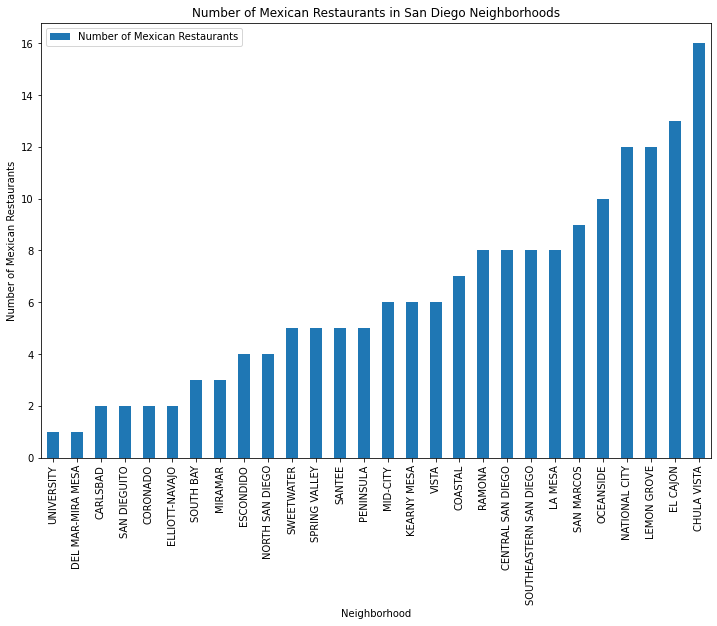

In [36]:
sd_sorted_grouped.plot(kind='bar', figsize=(12, 8))

plt.xlabel('Neighborhood') # add to x-label to the plot
plt.ylabel('Number of Mexican Restaurants') # add y-label to the plot
plt.title('Number of Mexican Restaurants in San Diego Neighborhoods') # add title to the plot

plt.show()

As we can see, there are a number of neighborhoods <4  Mexican restaurants, most have ~4-10, and 2 neighborhoods have 13+ Mexican restaurants.  Let's ensure there are no neighborhoods that were missed (i.e. number of Mexican restaurants = 0).

In [37]:
sd_sorted_grouped.shape

(28, 1)

In [38]:
sd_merged.shape

(29, 14)

It seems all our n=29 neighborhoods are accounted for, and all have at least 1 Mexican restaurant.

#### The next 3 cells are commented out, but were used to identify neighborhoods with n=0 Mexican restaurants.  After revising my neighborhood venue radius and KMeans model, these were no longer needed

In [39]:
#neigh_dict = {}
#for neighborhood, venue_category in zip(sd_venues['Neighborhood'], sd_venues['Venue Category']):
    #if neighborhood not in neigh_dict:
        #neigh_dict[neighborhood] = [venue_category]
    #else:
        #neigh_dict[neighborhood].append(venue_category)
#neigh_dict

In [40]:
# account for alternative venue categories, such as 'Taco place', 'burrito place', 'Tex-Mex' etc.
#no_mex = []
#for neighborhood in neigh_dict:
    #for venue_cat in neigh_dict[neighborhood]:
        #x = re.compile("Mex.")
        #y = re.compile("Taco.")
        #z = re.compile("Burrito.")
        #zz = re.compile(".Mex.")

        #match_x = bool(re.match(x, venue_cat))
        #match_y = bool(re.match(y, venue_cat))
        #match_z = bool(re.match(z, venue_cat))
        #match_zz = bool(re.match(zz, venue_cat))
        
        
        #if (match_x | match_y | match_z | match_zz) & (neighborhood not in no_mex):
            #no_mex.append(neighborhood)
#no_mex

In [41]:
# identify the neighborhoods which have no Mexican restaurants
#for neighborhood in sd_merged['Neighborhood']:
    #if neighborhood not in no_mex:
        #print(neighborhood + " has no Mexican restaurants in the immediate area.")

Since all neighborhoods are accounted for, we will now create a heat map to better visualize the concentration of Mexican restaurants around San Diego.

In [42]:
sd_location = [location.latitude, location.longitude]
sd_location

[32.7174202, -117.1627728]

In [43]:
mex_restaurant_latlons = [[lat, lon] for lat, lon in zip(sd_mex_venues['Venue Latitude'], sd_mex_venues['Venue Longitude'])]
mex_restaurant_latlons

[[32.7177492877035, -117.1584974229391],
 [32.72027940977426, -117.15925790806186],
 [32.7150214, -117.1642958],
 [32.7108520879202, -117.16113045253795],
 [32.711093, -117.161181],
 [32.723081, -117.16773],
 [32.713852724495034, -117.15302773865932],
 [32.71457390926671, -117.15576118796484],
 [32.73086620713531, -117.22410962735086],
 [32.722418880391224, -117.23000569298286],
 [32.72153020656626, -117.2302966324671],
 [32.727406, -117.22723],
 [32.74046370066948, -117.22908157353397],
 [32.682587, -117.17753],
 [32.68580755645162, -117.1793996498688],
 [32.66791197763916, -117.09503050823145],
 [32.6605132, -117.1055349],
 [32.6618, -117.08251],
 [32.685818, -117.101179],
 [32.6602655, -117.0835576],
 [32.64128872434735, -117.09440129657716],
 [32.684489721271014, -117.07489780986053],
 [32.69429285196763, -117.10255511613185],
 [32.689802723176605, -117.08602527539013],
 [32.660113, -117.07208500000002],
 [32.642478999999994, -117.080675],
 [32.64313265544326, -117.08042000266524],

In [44]:
from folium import plugins
from folium.plugins import HeatMap

map_heat = folium.Map(location=sd_location, zoom_start=10)
folium.TileLayer('cartodbpositron').add_to(map_heat) #cartodbpositron cartodbdark_matter
HeatMap(mex_restaurant_latlons).add_to(map_heat)
folium.Marker(sd_location).add_to(map_heat)

for lat, lng, neighborhood in zip(sd_geo_cleaned['Lat'], sd_geo_cleaned['Lon'], sd_geo_cleaned['Neighborhood']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_heat)

folium.GeoJson(sd_neighborhoods, style_function=neighborhood_style, name='geojson').add_to(map_heat)
map_heat

So now we have an idea of the neighborhoods with the most Mexican restaurants today.  However, we don't really know much more about the neighborhoods apart from how many Mexican restaurants are in each, and the most common venues found in each.  Let's pull in some demographic data to further explore each neighborhood's characteristics.

We will begin by examining the total popluation of San Diego, then we will take a look at the ethnic makeupof each neighborhood, obtained from San Diego census data.

In [45]:
ethnic_data = pd.read_csv('2017_San_Diego_County_Demographics_-_Race_and_Ethnicity.csv')
ethnic_data.head()

,Geography,Hispanic,Percent Hispanic,White,Percent White,Black,Percent Black,API,Percent API,AIAN,Percent AIAN,Other,Percent Other
0,Central Region,217672,0.4,153475,0.3,56358,0.1,67943,0.1,1248,0.0,14964,0.0
1,Central San Diego,58777,0.3,87442,0.5,10628,0.1,9826,0.1,537,0.0,4956,0.0
2,Mid-City,71326,0.4,49962,0.3,22166,0.1,25756,0.1,256,0.0,5231,0.0
3,Southeastern San Diego,87569,0.5,16071,0.1,23564,0.1,32361,0.2,455,0.0,4777,0.0
4,East Region,135614,0.3,277918,0.6,27259,0.1,24458,0.0,2708,0.0,20373,0.0


As before, we will be focusing on the core San Diego neighborhoods closest to the city center, and will be ingoring the outermost county areas that are not traditionally considered part of the City of San Diego.  Let's clean up the dataset.

In [46]:
removals = ['LAGUNA-PINE VALLEY', 'ANZA-BORREGO SPRINGS', 'MOUNTAIN EMPIRE', 'ALPINE', 'PALOMAR-JULIAN', 'PAUMA', 'FALLBROOK', 'PENDLETON', 'VALLEY CENTER', 'JAMUL', 'LAKESIDE', 'HARBISON-CREST']
ethnic_data = ethnic_data[~ethnic_data['Geography'].str.upper().isin(removals)]
ethnic_data = ethnic_data[~(ethnic_data['Geography'].str.contains('Region') | ethnic_data['Geography'].str.contains('County'))]
ethnic_data['Geography']=ethnic_data['Geography'].str.upper()
ethnic_data.rename(columns={'Geography': 'Neighborhood'}, inplace=True)
ethnic_data.head()

,Neighborhood,Hispanic,Percent Hispanic,White,Percent White,Black,Percent Black,API,Percent API,AIAN,Percent AIAN,Other,Percent Other
1,CENTRAL SAN DIEGO,58777,0.3,87442,0.5,10628,0.1,9826,0.1,537,0.0,4956,0.0
2,MID-CITY,71326,0.4,49962,0.3,22166,0.1,25756,0.1,256,0.0,5231,0.0
3,SOUTHEASTERN SAN DIEGO,87569,0.5,16071,0.1,23564,0.1,32361,0.2,455,0.0,4777,0.0
6,EL CAJON,38158,0.3,75168,0.6,6648,0.1,4918,0.0,233,0.0,6268,0.0
9,LA MESA,15762,0.3,34587,0.6,4021,0.1,3714,0.1,209,0.0,3145,0.1


First, we will identify the neighborhoods with the greatest population densities.  Let's total up the population for each.

In [47]:
ethnic_data_sum = ethnic_data[['Neighborhood', 'Hispanic', 'White', 'Black', 'API', 'AIAN', 'Other']]
ethnic_data_sum['Total'] = ethnic_data_sum.sum(axis=1)
ethnic_data_sum_sub = ethnic_data_sum[['Neighborhood', 'Total']]
ethnic_data_sum_sub

<ipython-input-47-cb6a86196b4b>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ethnic_data_sum['Total'] = ethnic_data_sum.sum(axis=1)


,Neighborhood,Total
1,CENTRAL SAN DIEGO,172166
2,MID-CITY,174697
3,SOUTHEASTERN SAN DIEGO,164797
6,EL CAJON,131393
9,LA MESA,61438
12,LEMON GROVE,31164
14,SANTEE,53863
15,SPRING VALLEY,86672
17,COASTAL,79785
18,DEL MAR-MIRA MESA,173917


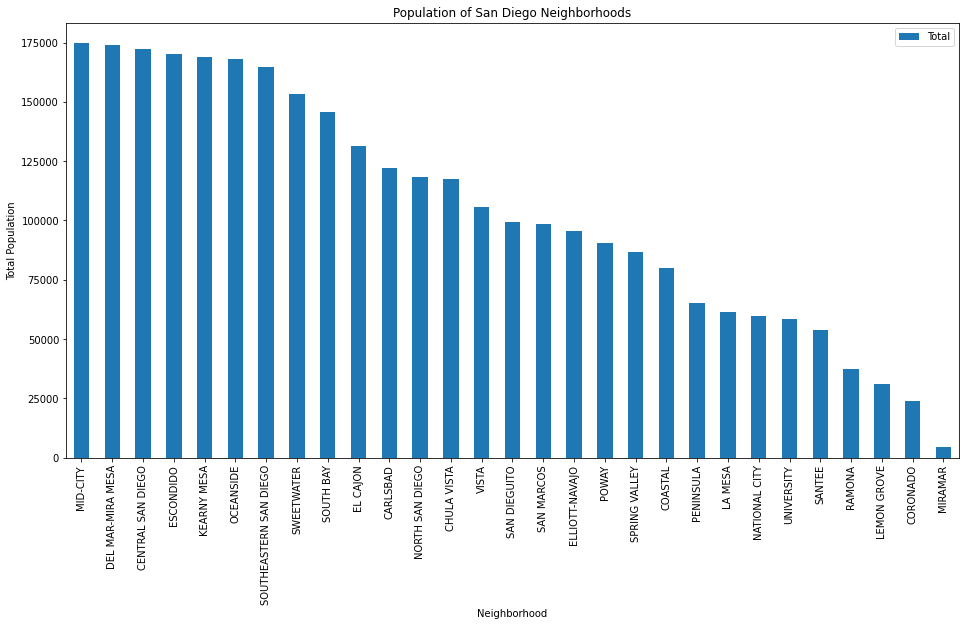

In [48]:
ethnic_data_sum_sub.set_index('Neighborhood').sort_values('Total', ascending = False).plot(kind='bar', figsize=(16, 8))
#ethnic_data_sum_sub.sort_values('Total')
#ethnic_data_sum_sub.plot(kind='bar', figsize=(16, 10))

plt.xlabel('Neighborhood') # add to x-label to the plot
plt.ylabel('Total Population') # add y-label to the plot
plt.title('Population of San Diego Neighborhoods') # add title to the plot

plt.show()

Let's put this into a choropleth map for better visualization.

In [49]:
sd_pop = folium.Map(location = [latitude, longitude], zoom_start = 10)
choropleth = folium.Choropleth(
    geo_data=sd_neighborhoods,
    data=ethnic_data_sum_sub,
    columns=['Neighborhood', 'Total'],
    key_on='feature.properties.NAME',
    fill_color='YlGnBu', 
    fill_opacity=0.4, 
    line_opacity=0.4,
    legend_name='Total Population',
    highlight=True,
    smooth_factor=0).add_to(sd_pop)

folium.LayerControl().add_to(sd_pop)

style_function = "font-size: 15px; font-weight: bold"
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['NAME'], labels=False))


sd_pop

As expected, the areas nearest to downtown and central San Diego have the greatest population densities, and population density decreases as you travel further from the city center.

Let's take a look at ethnic makeup of each neighborhood.

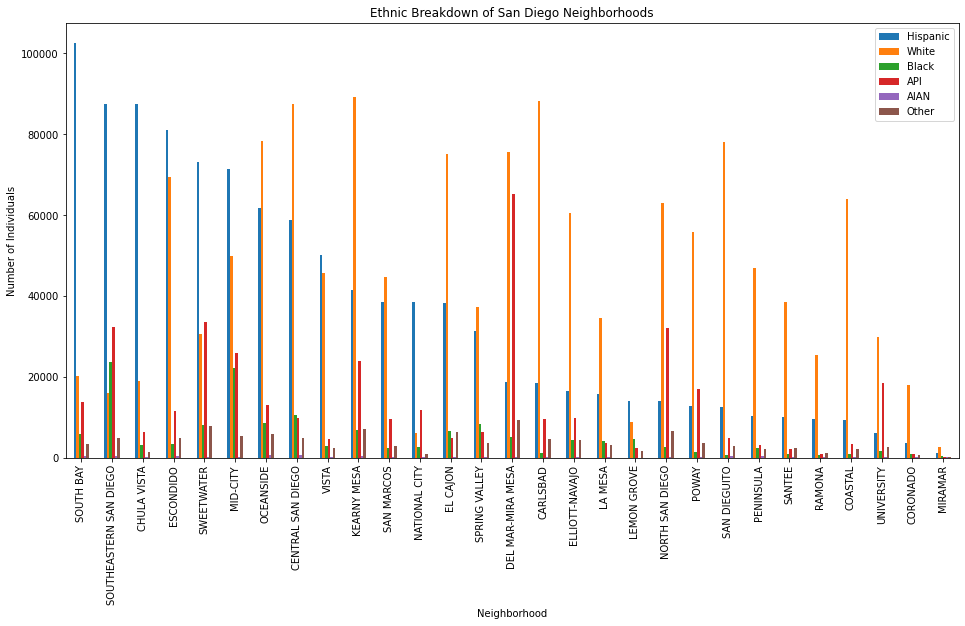

In [50]:
ethnic_data_sum.drop(columns=['Total']).sort_values(by='Hispanic', ascending = False).set_index('Neighborhood').plot(kind='bar', figsize=(16, 8))

plt.xlabel('Neighborhood') # add to x-label to the plot
plt.ylabel('Number of Individuals') # add y-label to the plot
plt.title('Ethnic Breakdown of San Diego Neighborhoods') # add title to the plot

plt.show()

As we can see, there are a large number of White and Hispanic people in many of the neighborhoods around the city.  Let's take a closer look at the Hispanic population, who may be a key target market for a new Mexican restaurant.

In [51]:
ethnic_data.head()

,Neighborhood,Hispanic,Percent Hispanic,White,Percent White,Black,Percent Black,API,Percent API,AIAN,Percent AIAN,Other,Percent Other
1,CENTRAL SAN DIEGO,58777,0.3,87442,0.5,10628,0.1,9826,0.1,537,0.0,4956,0.0
2,MID-CITY,71326,0.4,49962,0.3,22166,0.1,25756,0.1,256,0.0,5231,0.0
3,SOUTHEASTERN SAN DIEGO,87569,0.5,16071,0.1,23564,0.1,32361,0.2,455,0.0,4777,0.0
6,EL CAJON,38158,0.3,75168,0.6,6648,0.1,4918,0.0,233,0.0,6268,0.0
9,LA MESA,15762,0.3,34587,0.6,4021,0.1,3714,0.1,209,0.0,3145,0.1


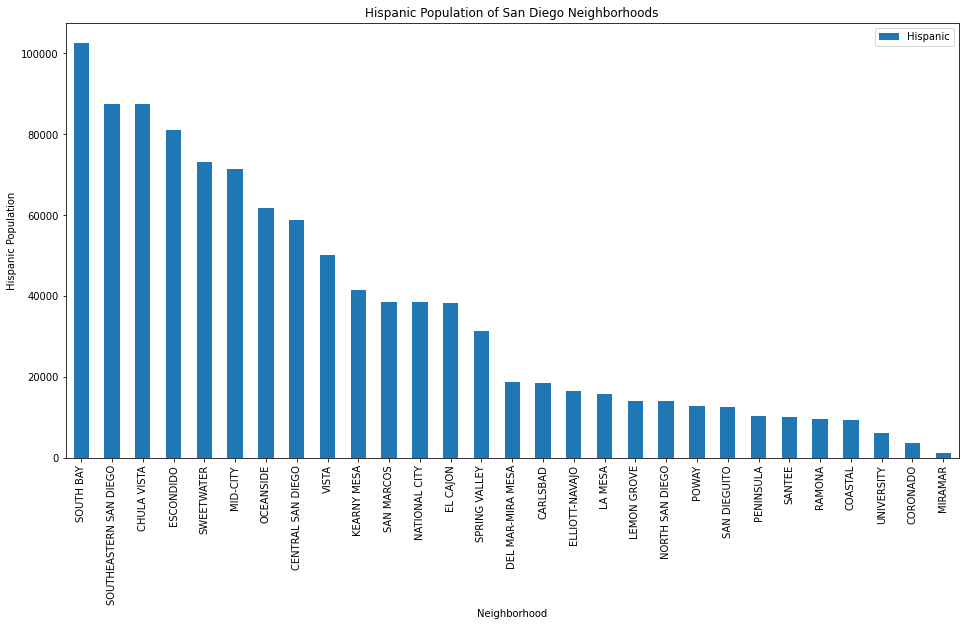

In [52]:
ethnic_data_hisp = ethnic_data[['Neighborhood', 'Hispanic']]
ethnic_data_hisp.set_index('Neighborhood').sort_values(by='Hispanic', ascending = False).plot(kind='bar', figsize=(16, 8))

plt.xlabel('Neighborhood') # add to x-label to the plot
plt.ylabel('Hispanic Population') # add y-label to the plot
plt.title('Hispanic Population of San Diego Neighborhoods') # add title to the plot

plt.show()

In [53]:
hisp_pop = folium.Map(location = [latitude, longitude], zoom_start = 11)
choropleth = folium.Choropleth(
    geo_data=sd_neighborhoods,
    data=ethnic_data,
    columns=['Neighborhood', 'Percent Hispanic'],
    key_on='feature.properties.NAME',
    fill_color='YlGnBu', 
    fill_opacity=0.4, 
    line_opacity=0.4,
    legend_name='Total Population',
    highlight=True,
    smooth_factor=0).add_to(hisp_pop)

folium.LayerControl().add_to(hisp_pop)

style_function = "font-size: 15px; font-weight: bold"
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['NAME'], labels=False))

hisp_pop

As we can see above, it seems the South/Southeastern region of San Diego, namely National City, Chula Vista, and the South Bay, have the highest Hispanic populations by percentage.  We can see some overlap with the heat map showing number of Mexican restaurants, but should pay attention to neighborhoods with high Hispanic populations but little Mexican restaurants.

So we've explored the ethnic makeup of our neighborhoods. Now I would like to take a look at the age breakdown in each neighborhood. We will assume that we will want to target neighborhoods with high percentages of key age groups that would most frequent a new Mexican restaurant.

In [54]:
age_gender = pd.read_csv('2015_San_Diego_County_Demographics_-_County_Population_by_Age_and_Gender.csv')
age_gender = age_gender[~(age_gender['Geography'].str.contains('Region') | age_gender['Geography'].str.contains('County'))]

removals = ['LAGUNA-PINE VALLEY', 'ANZA-BORREGO SPRINGS', 'MOUNTAIN EMPIRE', 'ALPINE', 'PALOMAR-JULIAN', 'PAUMA', 'FALLBROOK', 'PENDLETON', 'VALLEY CENTER', 'JAMUL', 'LAKESIDE', 'HARBISON CREST']
age_gender = age_gender[~age_gender['Geography'].str.upper().isin(removals)]
age_gender.rename(columns={'Geography': 'Neighborhood'}, inplace=True)
age_gender.head()

,Neighborhood,Total Population,Estimate 0-4,Percent 0-4,Estimate 5-14,Percent 5-14,Estimate 15-24,Percent 15-24,Estimate 25-44,Percent 25-44,Estimate 45-64,Percent 45-64,Estimate 65+,Percent 65+,Estimate Male,Percent Male,Estimate Female,Percent Female
1,Central San Diego,169456,8196,4.8,11037,6.5,21508,12.7,73500,43.4,37728,22.3,17487,10.3,91760,54.1,77696,45.9
2,Mid-City,169472,12031,7.1,20649,12.2,34787,20.5,52693,31.1,35520,21.0,13792,8.1,84186,49.7,85286,50.3
3,Southeastern San Diego,164917,13063,7.9,24322,14.7,27177,16.5,45714,27.7,37747,22.9,16894,10.2,80895,49.1,84022,50.9
6,El Cajon,129950,8962,6.9,17412,13.4,20330,15.6,35050,27.0,32152,24.7,16044,12.3,65878,50.7,64072,49.3
9,La Mesa,61282,4209,6.9,6483,10.6,7584,12.4,18754,30.6,15071,24.6,9181,15.0,29331,47.9,31951,52.1


Let's take a look at the age group of 15 - 64. This age group should encapsulate the most likely customers that will be eating at ournew  restaurant - teenagers, college students, working age adults, parents, and possibly grandparents who may be taking family out to eat on occasion.

In [55]:
#age_gender.columns
age_gender = age_gender[['Neighborhood', 'Percent 15-24', 'Percent 25-44']]
age_gender['Percent 15-44'] = age_gender.sum(axis=1)
age_gender = age_gender.sort_values(by='Percent 15-44', ascending = False)
age_gender['Neighborhood'] = age_gender['Neighborhood'].str.upper()
age_gender.head(30)

,Neighborhood,Percent 15-24,Percent 25-44,Percent 15-44
20,MIRAMAR,56.9,23.4,80.3
22,UNIVERSITY,23.8,37.7,61.5
1,CENTRAL SAN DIEGO,12.7,43.4,56.1
17,COASTAL,14.6,37.2,51.8
21,PENINSULA,20.0,31.7,51.7
2,MID-CITY,20.5,31.1,51.6
19,KEARNY MESA,15.4,32.8,48.2
43,NATIONAL CITY,19.0,28.7,47.7
28,VISTA,14.3,30.9,45.2
44,SOUTH BAY,17.3,27.9,45.2


Miramar is a clear outlier with >80% of people aged 15-24, but due to its low population as observed earlier in this analysis, we will remove it from this section of analysis.  Let's visualize.

In [56]:
age_gender_2 = age_gender.drop(20)
age_pop = folium.Map(location = [latitude, longitude], zoom_start = 10)
choropleth = folium.Choropleth(
    geo_data=sd_neighborhoods,
    data=age_gender_2,
    columns=['Neighborhood', 'Percent 15-44'],
    key_on='feature.properties.NAME',
    fill_color='YlGnBu', 
    fill_opacity=0.4, 
    line_opacity=0.4,
    legend_name='Age Breakdown of Population',
    highlight=True,
    smooth_factor=0).add_to(age_pop)

folium.LayerControl().add_to(age_pop)

style_function = "font-size: 15px; font-weight: bold"
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['NAME'], labels=False))

age_pop

Apart from Miramar, the neighborhoods of University, Central San Diego, Coastal, Peninsula and Mid-City contain the highest percentage of people aged 15-44,, which makes logical sense - University contains a major U.S. university, my alma mater UC San Diego, of which many students live in the coastal region, and Central San Diego is where the downtown area. but all neighborhoods are at least 35% comprised of people ages 15-44.  I think we should be pretty solid regardless where we decide to build our restaurant based on age breakdown of the neighborhoods, but we can hone in on areas where the neighborhood has >50% prevalence of ages 15-44.

Let's take a look now at income breakdown by neighborhood.


In [57]:
income = pd.read_csv('2016_San_Diego_County_Demographics_-_Number_of_Households_by_Household_Income.csv')
income = income[~(income['Geography'].str.contains('Region') | income['Geography'].str.contains('County'))]

removals = ['LAGUNA-PINE VALLEY', 'ANZA-BORREGO SPRINGS', 'MOUNTAIN EMPIRE', 'ALPINE', 'PALOMAR-JULIAN', 'PAUMA', 'FALLBROOK', 'PENDLETON', 'VALLEY CENTER', 'JAMUL', 'LAKESIDE', 'HARBISON-CREST']
income = income[~income['Geography'].str.upper().isin(removals)]
income.rename(columns={'Geography': 'Neighborhood'}, inplace=True)
income.head()

,Neighborhood,"Under $35,000 (#)","Under $35,000 (%)","$35,000-under $50,000 (#)","$35,000-under $50,000 (%)","$50,000-under $75,000 (#)","$50,000-under $75,000 (%)","$75,000- under $100,000 (#)","$75,000- under $100,000 (%)","$100,000- under $150,000 (#)","$100,000- under $150,000 (%)","$150,000 and Higher (#)","$150,000 and Higher (%)"
1,Central San Diego,24985,32.0,9710,12.5,14082,18.1,8891,11.4,10175,13.1,10125,13.0
2,Mid-City,23243,40.5,8780,15.3,9914,17.3,5881,10.2,5962,10.4,3671,6.4
3,Southeastern San Diego,14257,33.1,6722,15.6,8318,19.3,5555,12.9,5693,13.2,2558,5.9
6,El Cajon,15864,37.7,5306,12.6,7154,17.0,4917,11.7,5010,11.9,3813,9.1
9,La Mesa,7002,28.4,3418,13.9,4659,18.9,3721,15.1,3745,15.2,2122,8.6


In [58]:
income.shape

(29, 13)

We have our 29 neighborhoods accounted for.  Let's clean up our dataset to focus on neighborhoods with the highest percentage of people in the high and low extreme brackets.

In [59]:
income = income.iloc[:, [0,2,10,12]]
income['Neighborhood'] = income['Neighborhood'].str.upper()
income.set_index('Neighborhood', inplace=True)
income.sort_values(by='Under $35,000 (%)', ascending = False, inplace = True)

In [60]:
income.head()

,"Under $35,000 (%)","$100,000- under $150,000 (%)","$150,000 and Higher (%)"
Neighborhood,,,
NATIONAL CITY,43.1,8.5,4.1
MID-CITY,40.5,10.4,6.4
CHULA VISTA,38.9,10.1,4.0
EL CAJON,37.7,11.9,9.1
SOUTHEASTERN SAN DIEGO,33.1,13.2,5.9


Let's take a look at the percentage of the population making less than $35,000 per year in each neighborhood.

In [61]:
count, bin_edges = np.histogram(income['Under $35,000 (%)'])

print(count) # frequency count
print(bin_edges) # bin ranges, default = 10 bins

[3 3 5 1 3 5 5 0 2 2]
[11.8  14.93 18.06 21.19 24.32 27.45 30.58 33.71 36.84 39.97 43.1 ]


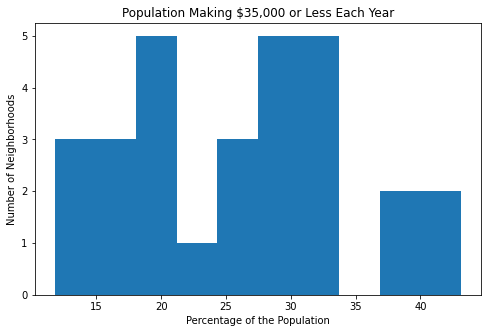

In [62]:
income['Under $35,000 (%)'].plot(kind='hist', figsize=(8, 5))

plt.title('Population Making $35,000 or Less Each Year') # add a title to the histogram
plt.ylabel('Number of Neighborhoods') # add y-label
plt.xlabel('Percentage of the Population') # add x-label

plt.show()

There seem to be several neighborhoods where more than 30% of the population makes $35,000 or less per year.

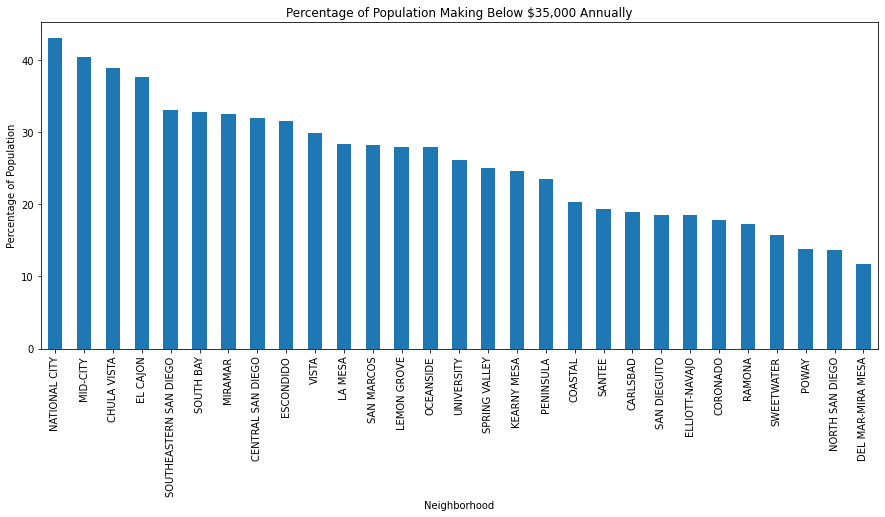

In [63]:
income['Under $35,000 (%)'].plot(kind='bar', figsize=(15, 6))

plt.xlabel('Neighborhood') # add to x-label to the plot
plt.ylabel('Percentage of Population') # add y-label to the plot
plt.title('Percentage of Population Making Below $35,000 Annually') # add title to the plot

plt.show()

Let's visualize this breakdown in a choropleth map.

In [64]:
income_pop = folium.Map(location = [latitude, longitude], zoom_start = 11)
choropleth = folium.Choropleth(
    geo_data=sd_neighborhoods,
    data=income.reset_index(),
    columns=['Neighborhood', 'Under $35,000 (%)'],
    key_on='feature.properties.NAME',
    fill_color='YlGnBu', 
    fill_opacity=0.4, 
    line_opacity=0.4,
    legend_name='Income Breakdown of Population',
    highlight=True,
    smooth_factor=0).add_to(income_pop)

folium.LayerControl().add_to(income_pop)

style_function = "font-size: 15px; font-weight: bold"
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['NAME'], labels=False))

income_pop

Neighborhoods around southeast San Diego seem to have the highest proportion of the population making 35,000 or less. Let's take a look at the high extreme, people making 100,000 or more annually.

In [65]:
income['$100,000 and Higher (%)'] = income['$100,000- under $150,000 (%)']+income['$150,000 and Higher (%)']

In [66]:
income.sort_values('$100,000 and Higher (%)', ascending=False, inplace=True)
income

,"Under $35,000 (%)","$100,000- under $150,000 (%)","$150,000 and Higher (%)","$100,000 and Higher (%)"
Neighborhood,,,,
DEL MAR-MIRA MESA,11.8,22.3,34.1,56.4
POWAY,13.8,22.3,31.5,53.8
NORTH SAN DIEGO,13.7,22.0,30.2,52.2
SAN DIEGUITO,18.5,18.3,33.1,51.4
CORONADO,17.8,18.6,27.7,46.3
CARLSBAD,18.9,19.6,25.4,45.0
SWEETWATER,15.8,25.6,18.4,44.0
COASTAL,20.4,16.3,24.7,41.0
ELLIOTT-NAVAJO,18.5,19.0,20.5,39.5


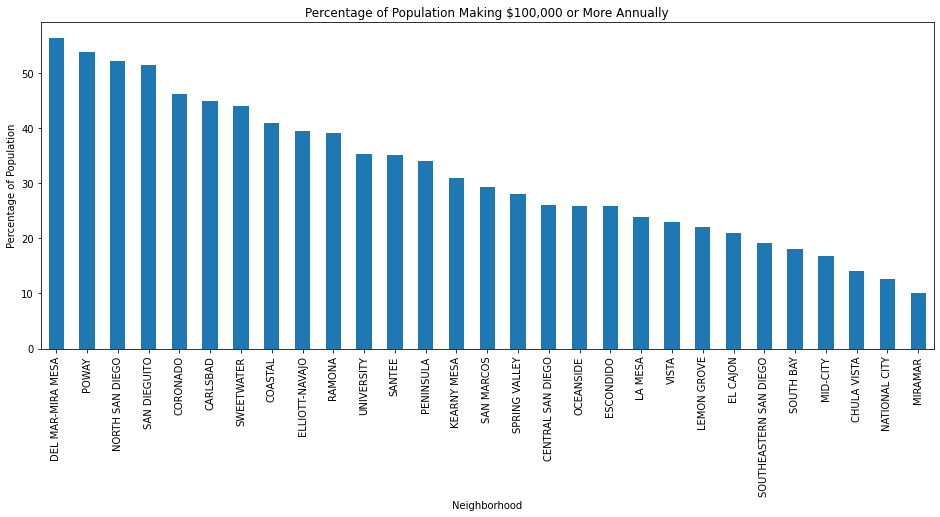

In [67]:
income['$100,000 and Higher (%)'].plot(kind='bar', figsize=(16, 6))

plt.xlabel('Neighborhood') # add to x-label to the plot
plt.ylabel('Percentage of Population') # add y-label to the plot
plt.title('Percentage of Population Making $100,000 or More Annually') # add title to the plot

plt.show()

In [68]:
high_income_pop = folium.Map(location = [latitude, longitude], zoom_start = 11)
choropleth = folium.Choropleth(
    geo_data=sd_neighborhoods,
    data=income.reset_index(),
    columns=['Neighborhood', '$100,000 and Higher (%)'],
    key_on='feature.properties.NAME',
    fill_color='YlGnBu', 
    fill_opacity=0.4, 
    line_opacity=0.4,
    legend_name='High Breakdown of Population',
    highlight=True,
    smooth_factor=0).add_to(high_income_pop)

folium.LayerControl().add_to(high_income_pop)

style_function = "font-size: 15px; font-weight: bold"
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['NAME'], labels=False))

high_income_pop

We can see the high concentration of people who make $100,000 or more each year in North San Diego and the surrounding neighborhoods of Del Mar-Mira Mesa, Poway, and San Dieguito (which includes Encinitas, Solana Beach and Rancho Santa Fe, all very upscale areas).  In these neighborhoods, we may be able to take a premium approach if we choose to open a restaurant here, but real estate prices are also higher here, so there are many considerations we must make.

Finally, I want to see if there is any insight to be gleaned by looking at the percentage of the population that walks to work, as foot traffic can be a reliable source of repeat customers stopping by for a bite to enjoy at home.

In [69]:
transport = pd.read_csv('2015_San_Diego_County_Demographics_-_Vehicles_and_Transportation_to_Work.csv')
transport = transport[~(transport['Geography'].str.contains('Region') | transport['Geography'].str.contains('County'))]

removals = ['LAGUNA-PINE VALLEY', 'ANZA-BORREGO SPRINGS', 'MOUNTAIN EMPIRE', 'ALPINE', 'PALOMAR-JULIAN', 'PAUMA', 'FALLBROOK', 'PENDLETON', 'VALLEY CENTER', 'JAMUL', 'LAKESIDE', 'HARBISON CREST']
transport = transport[~transport['Geography'].str.upper().isin(removals)]
transport.sort_values(by='Walked', ascending = False, inplace=True)
transport.rename(columns={'Geography': 'Neighborhood'}, inplace=True)
transport.head()

,Neighborhood,Occupied Housing Units,No vehicle,1 vehicle,2 vehicles,3+ vehicles,Workers Age 16+,Drove alone,Carpooled,Public transportation,Walked,Other,Worked at home
21,Miramar,532,0.8,39.3,49.8,10.2,3511,23.5,11.0,0.0,21.5,1.2,42.8
1,Central San Diego,76359,13.9,47.3,31.1,7.8,98730,66.3,7.8,6.2,7.6,3.3,8.8
43,Coronado,8500,5.0,37.2,40.3,17.5,12905,57.1,5.6,1.4,7.6,5.9,22.5
22,Peninsula,25058,6.4,41.2,38.4,14.0,36334,66.6,5.4,2.0,6.2,4.1,15.6
17,Coastal,35045,5.5,39.9,39.1,15.5,43801,75.7,5.4,2.4,3.3,3.7,9.5


In [70]:
transport = transport[['Neighborhood', 'Walked']]
transport

,Neighborhood,Walked
21,Miramar,21.5
1,Central San Diego,7.6
43,Coronado,7.6
22,Peninsula,6.2
17,Coastal,3.3
2,Mid-City,3.2
44,National City,3.0
23,University,2.9
28,San Dieguito,2.2
42,Chula Vista,2.2


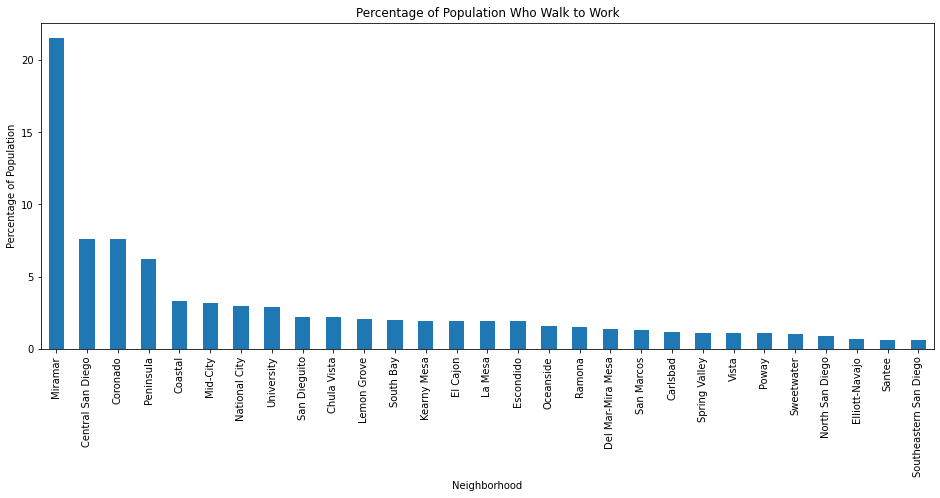

In [71]:
transport.set_index('Neighborhood')['Walked'].plot(kind='bar', figsize=(16, 6))

plt.xlabel('Neighborhood') # add to x-label to the plot
plt.ylabel('Percentage of Population') # add y-label to the plot
plt.title('Percentage of Population Who Walk to Work') # add title to the plot

plt.show()

Overall, a small percentage of the population walks to work, but in Miramar, Central San Diego, Coronado, and Peninsula, we may have higher chances of capturing some of the foot traffic of commuters walking by on their way to work.

Now want to combine all the tables and datapoints/labels, to make one big map with clusters and labels stating the categories for each (age, income, high/low hisp pop)

In [72]:
sd_merged.head()

,Neighborhood,Lat,Lon,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,CENTRAL SAN DIEGO,32.717214,-117.164099,3,Hotel,Italian Restaurant,Mexican Restaurant,American Restaurant,Bar,Park,Steakhouse,Taco Place,Museum,Gym
1,PENINSULA,32.729490,-117.226068,3,Seafood Restaurant,Italian Restaurant,Coffee Shop,Hotel,Park,Bar,Bakery,Sushi Restaurant,Thai Restaurant,Mexican Restaurant
2,CORONADO,32.665205,-117.162210,3,Park,Sandwich Place,Seafood Restaurant,Hotel,Beach,Mexican Restaurant,Gelato Shop,Surf Spot,Café,Harbor / Marina
3,NATIONAL CITY,32.665783,-117.099726,0,Mexican Restaurant,Fast Food Restaurant,Convenience Store,Chinese Restaurant,Filipino Restaurant,Coffee Shop,Steakhouse,Hotel,Park,Bakery
4,SOUTHEASTERN SAN DIEGO,32.697041,-117.060844,0,Mexican Restaurant,Pizza Place,Coffee Shop,Fried Chicken Joint,Grocery Store,Pharmacy,Supermarket,Asian Restaurant,Liquor Store,Park


In [73]:
#sd_sorted_grouped.loc['CORONADO'] = 0
#sd_sorted_grouped.loc['DEL MAR-MIRA MESA'] = 0
#sd_sorted_grouped.loc['ELLIOTT-NAVAJO'] = 0
sd_sorted_grouped.sort_values(by='Number of Mexican Restaurants', inplace=True)
sd_sorted_grouped.reset_index(inplace=True)
sd_sorted_grouped

,Neighborhood,Number of Mexican Restaurants
0,UNIVERSITY,1
1,DEL MAR-MIRA MESA,1
2,CARLSBAD,2
3,SAN DIEGUITO,2
4,CORONADO,2
5,ELLIOTT-NAVAJO,2
6,SOUTH BAY,3
7,MIRAMAR,3
8,ESCONDIDO,4
9,NORTH SAN DIEGO,4


In [74]:
def mex_rest(df):
    if df['Number of Mexican Restaurants']<5:
        return 'High Target'
    else:
        return 'Not High Target'

sd_sorted_grouped['Target Zone']=sd_sorted_grouped.apply(mex_rest, axis=1)
sd_sorted_grouped

,Neighborhood,Number of Mexican Restaurants,Target Zone
0,UNIVERSITY,1,High Target
1,DEL MAR-MIRA MESA,1,High Target
2,CARLSBAD,2,High Target
3,SAN DIEGUITO,2,High Target
4,CORONADO,2,High Target
5,ELLIOTT-NAVAJO,2,High Target
6,SOUTH BAY,3,High Target
7,MIRAMAR,3,High Target
8,ESCONDIDO,4,High Target
9,NORTH SAN DIEGO,4,High Target


Merging the master dataframe with venue and cluster information with the demographic datasets.

In [75]:
sd_merged_2 = pd.merge(sd_merged, sd_sorted_grouped, on='Neighborhood')
sd_merged_2.head()

,Neighborhood,Lat,Lon,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,Number of Mexican Restaurants,Target Zone
0,CENTRAL SAN DIEGO,32.717214,-117.164099,3,Hotel,Italian Restaurant,Mexican Restaurant,American Restaurant,Bar,Park,Steakhouse,Taco Place,Museum,Gym,8,Not High Target
1,PENINSULA,32.729490,-117.226068,3,Seafood Restaurant,Italian Restaurant,Coffee Shop,Hotel,Park,Bar,Bakery,Sushi Restaurant,Thai Restaurant,Mexican Restaurant,5,Not High Target
2,CORONADO,32.665205,-117.162210,3,Park,Sandwich Place,Seafood Restaurant,Hotel,Beach,Mexican Restaurant,Gelato Shop,Surf Spot,Café,Harbor / Marina,2,High Target
3,NATIONAL CITY,32.665783,-117.099726,0,Mexican Restaurant,Fast Food Restaurant,Convenience Store,Chinese Restaurant,Filipino Restaurant,Coffee Shop,Steakhouse,Hotel,Park,Bakery,12,Not High Target
4,SOUTHEASTERN SAN DIEGO,32.697041,-117.060844,0,Mexican Restaurant,Pizza Place,Coffee Shop,Fried Chicken Joint,Grocery Store,Pharmacy,Supermarket,Asian Restaurant,Liquor Store,Park,8,Not High Target


In [76]:
ethnic_data.rename(columns={'Geography': 'Neighborhood'}, inplace=True)

In [77]:
def conditions(df):
    if df['Percent Hispanic'] >= 0.5:
        return 'High Hispanic Population'
    elif (df['Percent Hispanic'] >= 0.3) & (df['Percent Hispanic'] < 0.5):
        return 'Medium Hispanic Population'
    else:
        return 'Low Hispanic Population'

ethnic_data['Hisp Pop'] = ethnic_data.apply(conditions, axis=1) 
ethnic_data

,Neighborhood,Hispanic,Percent Hispanic,White,Percent White,Black,Percent Black,API,Percent API,AIAN,Percent AIAN,Other,Percent Other,Hisp Pop
1,CENTRAL SAN DIEGO,58777,0.3,87442,0.5,10628,0.1,9826,0.1,537,0.0,4956,0.0,Medium Hispanic Population
2,MID-CITY,71326,0.4,49962,0.3,22166,0.1,25756,0.1,256,0.0,5231,0.0,Medium Hispanic Population
3,SOUTHEASTERN SAN DIEGO,87569,0.5,16071,0.1,23564,0.1,32361,0.2,455,0.0,4777,0.0,High Hispanic Population
6,EL CAJON,38158,0.3,75168,0.6,6648,0.1,4918,0.0,233,0.0,6268,0.0,Medium Hispanic Population
9,LA MESA,15762,0.3,34587,0.6,4021,0.1,3714,0.1,209,0.0,3145,0.1,Medium Hispanic Population
12,LEMON GROVE,13969,0.4,8832,0.3,4505,0.1,2265,0.1,0,0.0,1593,0.1,Medium Hispanic Population
14,SANTEE,9944,0.2,38501,0.7,908,0.0,2148,0.0,48,0.0,2314,0.0,Low Hispanic Population
15,SPRING VALLEY,31276,0.4,37212,0.4,8204,0.1,6307,0.1,170,0.0,3503,0.0,Medium Hispanic Population
17,COASTAL,9313,0.1,63920,0.8,803,0.0,3361,0.0,182,0.0,2206,0.0,Low Hispanic Population
18,DEL MAR-MIRA MESA,18615,0.1,75497,0.4,5047,0.0,65149,0.4,234,0.0,9375,0.1,Low Hispanic Population


In [78]:
ethnic_data_2 = ethnic_data[['Neighborhood', 'Percent Hispanic', 'Hisp Pop']]
ethnic_data_2

,Neighborhood,Percent Hispanic,Hisp Pop
1,CENTRAL SAN DIEGO,0.3,Medium Hispanic Population
2,MID-CITY,0.4,Medium Hispanic Population
3,SOUTHEASTERN SAN DIEGO,0.5,High Hispanic Population
6,EL CAJON,0.3,Medium Hispanic Population
9,LA MESA,0.3,Medium Hispanic Population
12,LEMON GROVE,0.4,Medium Hispanic Population
14,SANTEE,0.2,Low Hispanic Population
15,SPRING VALLEY,0.4,Medium Hispanic Population
17,COASTAL,0.1,Low Hispanic Population
18,DEL MAR-MIRA MESA,0.1,Low Hispanic Population


In [79]:
sd_merged_3 = pd.merge(sd_merged_2, ethnic_data_2, on='Neighborhood')
sd_merged_3.head()

,Neighborhood,Lat,Lon,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,Number of Mexican Restaurants,Target Zone,Percent Hispanic,Hisp Pop
0,CENTRAL SAN DIEGO,32.717214,-117.164099,3,Hotel,Italian Restaurant,Mexican Restaurant,American Restaurant,Bar,Park,Steakhouse,Taco Place,Museum,Gym,8,Not High Target,0.3,Medium Hispanic Population
1,PENINSULA,32.729490,-117.226068,3,Seafood Restaurant,Italian Restaurant,Coffee Shop,Hotel,Park,Bar,Bakery,Sushi Restaurant,Thai Restaurant,Mexican Restaurant,5,Not High Target,0.2,Low Hispanic Population
2,CORONADO,32.665205,-117.162210,3,Park,Sandwich Place,Seafood Restaurant,Hotel,Beach,Mexican Restaurant,Gelato Shop,Surf Spot,Café,Harbor / Marina,2,High Target,0.1,Low Hispanic Population
3,NATIONAL CITY,32.665783,-117.099726,0,Mexican Restaurant,Fast Food Restaurant,Convenience Store,Chinese Restaurant,Filipino Restaurant,Coffee Shop,Steakhouse,Hotel,Park,Bakery,12,Not High Target,0.6,High Hispanic Population
4,SOUTHEASTERN SAN DIEGO,32.697041,-117.060844,0,Mexican Restaurant,Pizza Place,Coffee Shop,Fried Chicken Joint,Grocery Store,Pharmacy,Supermarket,Asian Restaurant,Liquor Store,Park,8,Not High Target,0.5,High Hispanic Population


In [80]:
age_gender_2 = age_gender[['Neighborhood', 'Percent 15-44']]
age_gender_2

,Neighborhood,Percent 15-44
20,MIRAMAR,80.3
22,UNIVERSITY,61.5
1,CENTRAL SAN DIEGO,56.1
17,COASTAL,51.8
21,PENINSULA,51.7
2,MID-CITY,51.6
19,KEARNY MESA,48.2
43,NATIONAL CITY,47.7
28,VISTA,45.2
44,SOUTH BAY,45.2


In [81]:
def age_conditions(df):
    if df['Percent 15-44'] >= 50:
        return 'High Target Age Pop'
    else:
        return 'Low Target Age Pop'

age_gender_2['Target Age Pop'] = age_gender_2.apply(age_conditions, axis=1) 
#age_gender_2.rename(columns={'Geography': 'Neighborhood'}, inplace=True)
age_gender_2.head()

<ipython-input-81-97070948b0e4>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  age_gender_2['Target Age Pop'] = age_gender_2.apply(age_conditions, axis=1)


,Neighborhood,Percent 15-44,Target Age Pop
20,MIRAMAR,80.3,High Target Age Pop
22,UNIVERSITY,61.5,High Target Age Pop
1,CENTRAL SAN DIEGO,56.1,High Target Age Pop
17,COASTAL,51.8,High Target Age Pop
21,PENINSULA,51.7,High Target Age Pop


In [82]:
sd_merged_4 = pd.merge(sd_merged_3, age_gender_2, on='Neighborhood')
sd_merged_4.head()

,Neighborhood,Lat,Lon,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,Number of Mexican Restaurants,Target Zone,Percent Hispanic,Hisp Pop,Percent 15-44,Target Age Pop
0,CENTRAL SAN DIEGO,32.717214,-117.164099,3,Hotel,Italian Restaurant,Mexican Restaurant,American Restaurant,Bar,Park,Steakhouse,Taco Place,Museum,Gym,8,Not High Target,0.3,Medium Hispanic Population,56.1,High Target Age Pop
1,PENINSULA,32.729490,-117.226068,3,Seafood Restaurant,Italian Restaurant,Coffee Shop,Hotel,Park,Bar,Bakery,Sushi Restaurant,Thai Restaurant,Mexican Restaurant,5,Not High Target,0.2,Low Hispanic Population,51.7,High Target Age Pop
2,CORONADO,32.665205,-117.162210,3,Park,Sandwich Place,Seafood Restaurant,Hotel,Beach,Mexican Restaurant,Gelato Shop,Surf Spot,Café,Harbor / Marina,2,High Target,0.1,Low Hispanic Population,43.3,Low Target Age Pop
3,NATIONAL CITY,32.665783,-117.099726,0,Mexican Restaurant,Fast Food Restaurant,Convenience Store,Chinese Restaurant,Filipino Restaurant,Coffee Shop,Steakhouse,Hotel,Park,Bakery,12,Not High Target,0.6,High Hispanic Population,47.7,Low Target Age Pop
4,SOUTHEASTERN SAN DIEGO,32.697041,-117.060844,0,Mexican Restaurant,Pizza Place,Coffee Shop,Fried Chicken Joint,Grocery Store,Pharmacy,Supermarket,Asian Restaurant,Liquor Store,Park,8,Not High Target,0.5,High Hispanic Population,44.2,Low Target Age Pop


In [83]:
def high_income(df):
    if df['Under $35,000 (%)'] > 26:
        return 'Low Income'
    elif df['$100,000 and Higher (%)'] > 33:
        return 'High Income'
    else:
        return 'Middle Class'

income['Income Level']=income.apply(high_income, axis=1)
income.head(25)

,"Under $35,000 (%)","$100,000- under $150,000 (%)","$150,000 and Higher (%)","$100,000 and Higher (%)",Income Level
Neighborhood,,,,,
DEL MAR-MIRA MESA,11.8,22.3,34.1,56.4,High Income
POWAY,13.8,22.3,31.5,53.8,High Income
NORTH SAN DIEGO,13.7,22.0,30.2,52.2,High Income
SAN DIEGUITO,18.5,18.3,33.1,51.4,High Income
CORONADO,17.8,18.6,27.7,46.3,High Income
CARLSBAD,18.9,19.6,25.4,45.0,High Income
SWEETWATER,15.8,25.6,18.4,44.0,High Income
COASTAL,20.4,16.3,24.7,41.0,High Income
ELLIOTT-NAVAJO,18.5,19.0,20.5,39.5,High Income


In [84]:
income_2 = income.reset_index(inplace=True)
income_2 = income[['Neighborhood', 'Under $35,000 (%)', '$100,000 and Higher (%)', 'Income Level']]
income_2.head()

,Neighborhood,"Under $35,000 (%)","$100,000 and Higher (%)",Income Level
0,DEL MAR-MIRA MESA,11.8,56.4,High Income
1,POWAY,13.8,53.8,High Income
2,NORTH SAN DIEGO,13.7,52.2,High Income
3,SAN DIEGUITO,18.5,51.4,High Income
4,CORONADO,17.8,46.3,High Income


In [85]:
sd_merged_5 = pd.merge(sd_merged_4, income_2, on='Neighborhood')
sd_merged_5.head()

,Neighborhood,Lat,Lon,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,...,10th Most Common Venue,Number of Mexican Restaurants,Target Zone,Percent Hispanic,Hisp Pop,Percent 15-44,Target Age Pop,"Under $35,000 (%)","$100,000 and Higher (%)",Income Level
0,CENTRAL SAN DIEGO,32.717214,-117.164099,3,Hotel,Italian Restaurant,Mexican Restaurant,American Restaurant,Bar,Park,...,Gym,8,Not High Target,0.3,Medium Hispanic Population,56.1,High Target Age Pop,32.0,26.1,Low Income
1,PENINSULA,32.729490,-117.226068,3,Seafood Restaurant,Italian Restaurant,Coffee Shop,Hotel,Park,Bar,...,Mexican Restaurant,5,Not High Target,0.2,Low Hispanic Population,51.7,High Target Age Pop,23.5,34.1,High Income
2,CORONADO,32.665205,-117.162210,3,Park,Sandwich Place,Seafood Restaurant,Hotel,Beach,Mexican Restaurant,...,Harbor / Marina,2,High Target,0.1,Low Hispanic Population,43.3,Low Target Age Pop,17.8,46.3,High Income
3,NATIONAL CITY,32.665783,-117.099726,0,Mexican Restaurant,Fast Food Restaurant,Convenience Store,Chinese Restaurant,Filipino Restaurant,Coffee Shop,...,Bakery,12,Not High Target,0.6,High Hispanic Population,47.7,Low Target Age Pop,43.1,12.6,Low Income
4,SOUTHEASTERN SAN DIEGO,32.697041,-117.060844,0,Mexican Restaurant,Pizza Place,Coffee Shop,Fried Chicken Joint,Grocery Store,Pharmacy,...,Park,8,Not High Target,0.5,High Hispanic Population,44.2,Low Target Age Pop,33.1,19.1,Low Income


In [86]:
transport.head()

,Neighborhood,Walked
21,Miramar,21.5
1,Central San Diego,7.6
43,Coronado,7.6
22,Peninsula,6.2
17,Coastal,3.3


In [87]:
def walkable(df):
    if df['Walked'] > 6:
        return 'Walkable'
    else:
        return 'Not Walklable'
transport['Walkability']=transport.apply(walkable, axis=1)
transport.head(25)

,Neighborhood,Walked,Walkability
21,Miramar,21.5,Walkable
1,Central San Diego,7.6,Walkable
43,Coronado,7.6,Walkable
22,Peninsula,6.2,Walkable
17,Coastal,3.3,Not Walklable
2,Mid-City,3.2,Not Walklable
44,National City,3.0,Not Walklable
23,University,2.9,Not Walklable
28,San Dieguito,2.2,Not Walklable
42,Chula Vista,2.2,Not Walklable


In [88]:
transport['Neighborhood'] = transport['Neighborhood'].str.upper()
transport

,Neighborhood,Walked,Walkability
21,MIRAMAR,21.5,Walkable
1,CENTRAL SAN DIEGO,7.6,Walkable
43,CORONADO,7.6,Walkable
22,PENINSULA,6.2,Walkable
17,COASTAL,3.3,Not Walklable
2,MID-CITY,3.2,Not Walklable
44,NATIONAL CITY,3.0,Not Walklable
23,UNIVERSITY,2.9,Not Walklable
28,SAN DIEGUITO,2.2,Not Walklable
42,CHULA VISTA,2.2,Not Walklable


In [89]:
sd_merged_final = pd.merge(sd_merged_5, transport, on='Neighborhood')
sd_merged_final

,Neighborhood,Lat,Lon,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,...,Target Zone,Percent Hispanic,Hisp Pop,Percent 15-44,Target Age Pop,"Under $35,000 (%)","$100,000 and Higher (%)",Income Level,Walked,Walkability
0,CENTRAL SAN DIEGO,32.717214,-117.164099,3,Hotel,Italian Restaurant,Mexican Restaurant,American Restaurant,Bar,Park,...,Not High Target,0.3,Medium Hispanic Population,56.1,High Target Age Pop,32.0,26.1,Low Income,7.6,Walkable
1,PENINSULA,32.729490,-117.226068,3,Seafood Restaurant,Italian Restaurant,Coffee Shop,Hotel,Park,Bar,...,Not High Target,0.2,Low Hispanic Population,51.7,High Target Age Pop,23.5,34.1,High Income,6.2,Walkable
2,CORONADO,32.665205,-117.162210,3,Park,Sandwich Place,Seafood Restaurant,Hotel,Beach,Mexican Restaurant,...,High Target,0.1,Low Hispanic Population,43.3,Low Target Age Pop,17.8,46.3,High Income,7.6,Walkable
3,NATIONAL CITY,32.665783,-117.099726,0,Mexican Restaurant,Fast Food Restaurant,Convenience Store,Chinese Restaurant,Filipino Restaurant,Coffee Shop,...,Not High Target,0.6,High Hispanic Population,47.7,Low Target Age Pop,43.1,12.6,Low Income,3.0,Not Walklable
4,SOUTHEASTERN SAN DIEGO,32.697041,-117.060844,0,Mexican Restaurant,Pizza Place,Coffee Shop,Fried Chicken Joint,Grocery Store,Pharmacy,...,Not High Target,0.5,High Hispanic Population,44.2,Low Target Age Pop,33.1,19.1,Low Income,0.6,Not Walklable
5,MID-CITY,32.752167,-117.087728,0,Pizza Place,Vietnamese Restaurant,Mexican Restaurant,Thai Restaurant,Grocery Store,Café,...,Not High Target,0.4,Medium Hispanic Population,51.6,High Target Age Pop,40.5,16.8,Low Income,3.2,Not Walklable
6,KEARNY MESA,32.804919,-117.168752,2,Japanese Restaurant,Sushi Restaurant,Grocery Store,Pizza Place,Mexican Restaurant,Thai Restaurant,...,Not High Target,0.2,Low Hispanic Population,48.2,Low Target Age Pop,24.7,31.0,Middle Class,1.9,Not Walklable
7,COASTAL,32.818192,-117.243511,3,Pizza Place,Mexican Restaurant,Beach,Breakfast Spot,Park,Grocery Store,...,Not High Target,0.1,Low Hispanic Population,51.8,High Target Age Pop,20.4,41.0,High Income,3.3,Not Walklable
8,UNIVERSITY,32.877465,-117.222053,2,New American Restaurant,Cosmetics Shop,Burger Joint,Clothing Store,Juice Bar,Sandwich Place,...,High Target,0.1,Low Hispanic Population,61.5,High Target Age Pop,26.2,35.3,Low Income,2.9,Not Walklable
9,DEL MAR-MIRA MESA,32.934536,-117.184974,2,Park,Restaurant,Juice Bar,Nightclub,Coffee Shop,Bakery,...,High Target,0.1,Low Hispanic Population,41.5,Low Target Age Pop,11.8,56.4,High Income,1.4,Not Walklable


In [90]:
sd_merged_final_binary = sd_merged_final.copy()
sd_merged_final_binary

,Neighborhood,Lat,Lon,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,...,Target Zone,Percent Hispanic,Hisp Pop,Percent 15-44,Target Age Pop,"Under $35,000 (%)","$100,000 and Higher (%)",Income Level,Walked,Walkability
0,CENTRAL SAN DIEGO,32.717214,-117.164099,3,Hotel,Italian Restaurant,Mexican Restaurant,American Restaurant,Bar,Park,...,Not High Target,0.3,Medium Hispanic Population,56.1,High Target Age Pop,32.0,26.1,Low Income,7.6,Walkable
1,PENINSULA,32.729490,-117.226068,3,Seafood Restaurant,Italian Restaurant,Coffee Shop,Hotel,Park,Bar,...,Not High Target,0.2,Low Hispanic Population,51.7,High Target Age Pop,23.5,34.1,High Income,6.2,Walkable
2,CORONADO,32.665205,-117.162210,3,Park,Sandwich Place,Seafood Restaurant,Hotel,Beach,Mexican Restaurant,...,High Target,0.1,Low Hispanic Population,43.3,Low Target Age Pop,17.8,46.3,High Income,7.6,Walkable
3,NATIONAL CITY,32.665783,-117.099726,0,Mexican Restaurant,Fast Food Restaurant,Convenience Store,Chinese Restaurant,Filipino Restaurant,Coffee Shop,...,Not High Target,0.6,High Hispanic Population,47.7,Low Target Age Pop,43.1,12.6,Low Income,3.0,Not Walklable
4,SOUTHEASTERN SAN DIEGO,32.697041,-117.060844,0,Mexican Restaurant,Pizza Place,Coffee Shop,Fried Chicken Joint,Grocery Store,Pharmacy,...,Not High Target,0.5,High Hispanic Population,44.2,Low Target Age Pop,33.1,19.1,Low Income,0.6,Not Walklable
5,MID-CITY,32.752167,-117.087728,0,Pizza Place,Vietnamese Restaurant,Mexican Restaurant,Thai Restaurant,Grocery Store,Café,...,Not High Target,0.4,Medium Hispanic Population,51.6,High Target Age Pop,40.5,16.8,Low Income,3.2,Not Walklable
6,KEARNY MESA,32.804919,-117.168752,2,Japanese Restaurant,Sushi Restaurant,Grocery Store,Pizza Place,Mexican Restaurant,Thai Restaurant,...,Not High Target,0.2,Low Hispanic Population,48.2,Low Target Age Pop,24.7,31.0,Middle Class,1.9,Not Walklable
7,COASTAL,32.818192,-117.243511,3,Pizza Place,Mexican Restaurant,Beach,Breakfast Spot,Park,Grocery Store,...,Not High Target,0.1,Low Hispanic Population,51.8,High Target Age Pop,20.4,41.0,High Income,3.3,Not Walklable
8,UNIVERSITY,32.877465,-117.222053,2,New American Restaurant,Cosmetics Shop,Burger Joint,Clothing Store,Juice Bar,Sandwich Place,...,High Target,0.1,Low Hispanic Population,61.5,High Target Age Pop,26.2,35.3,Low Income,2.9,Not Walklable
9,DEL MAR-MIRA MESA,32.934536,-117.184974,2,Park,Restaurant,Juice Bar,Nightclub,Coffee Shop,Bakery,...,High Target,0.1,Low Hispanic Population,41.5,Low Target Age Pop,11.8,56.4,High Income,1.4,Not Walklable


In [91]:
sd_merged_final_binary['Target Zone BI'] = np.where(sd_merged_final_binary['Target Zone']=='High Target', 1, 0)
sd_merged_final_binary['Hisp Pop BI'] = np.where(sd_merged_final_binary['Hisp Pop']=='High Hispanic Population', 1, 0)
sd_merged_final_binary['Target Age Pop BI'] = np.where(sd_merged_final_binary['Target Age Pop']=='High Target Age Pop', 1, 0)
sd_merged_final_binary['Walkability BI'] = np.where(sd_merged_final_binary['Walkability']=='Walkable', 1, 0)
sd_merged_final_binary['Score'] = (sd_merged_final_binary['Target Zone BI'] + sd_merged_final_binary['Hisp Pop BI']+sd_merged_final_binary['Target Age Pop BI']+sd_merged_final_binary['Walkability BI'])
sd_merged_final_binary.drop(12).sort_values(by='Score', ascending=False).head(10)

,Neighborhood,Lat,Lon,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,...,"Under $35,000 (%)","$100,000 and Higher (%)",Income Level,Walked,Walkability,Target Zone BI,Hisp Pop BI,Target Age Pop BI,Walkability BI,Score
11,MIRAMAR,32.866796,-117.118713,0,Mexican Restaurant,Gym / Fitness Center,Indian Restaurant,Fast Food Restaurant,Hotel,Breakfast Spot,...,32.6,10.1,Low Income,21.5,Walkable,1,0,1,1,3
0,CENTRAL SAN DIEGO,32.717214,-117.164099,3,Hotel,Italian Restaurant,Mexican Restaurant,American Restaurant,Bar,Park,...,32.0,26.1,Low Income,7.6,Walkable,0,0,1,1,2
2,CORONADO,32.665205,-117.162210,3,Park,Sandwich Place,Seafood Restaurant,Hotel,Beach,Mexican Restaurant,...,17.8,46.3,High Income,7.6,Walkable,1,0,0,1,2
25,ESCONDIDO,33.126797,-117.035810,0,Mexican Restaurant,Fast Food Restaurant,Sandwich Place,Park,Coffee Shop,Chinese Restaurant,...,31.6,25.8,Low Income,1.9,Not Walklable,1,1,0,0,2
15,SOUTH BAY,32.567461,-117.019407,0,Convenience Store,Fast Food Restaurant,Coffee Shop,Pharmacy,Cosmetics Shop,Department Store,...,32.8,18.1,Low Income,2.0,Not Walklable,1,1,0,0,2
1,PENINSULA,32.729490,-117.226068,3,Seafood Restaurant,Italian Restaurant,Coffee Shop,Hotel,Park,Bar,...,23.5,34.1,High Income,6.2,Walkable,0,0,1,1,2
8,UNIVERSITY,32.877465,-117.222053,2,New American Restaurant,Cosmetics Shop,Burger Joint,Clothing Store,Juice Bar,Sandwich Place,...,26.2,35.3,Low Income,2.9,Not Walklable,1,0,1,0,2
23,CARLSBAD,33.133189,-117.284891,2,Hotel,Brewery,Theme Park,Sandwich Place,American Restaurant,Coffee Shop,...,18.9,45.0,High Income,1.2,Not Walklable,1,0,0,0,1
22,SAN DIEGUITO,33.044307,-117.225839,4,Coffee Shop,Restaurant,Vegetarian / Vegan Restaurant,Café,Burger Joint,Taco Place,...,18.5,51.4,High Income,2.2,Not Walklable,1,0,0,0,1
13,SWEETWATER,32.640138,-116.990654,0,Mexican Restaurant,Fast Food Restaurant,Sandwich Place,Pharmacy,Coffee Shop,Chinese Restaurant,...,15.8,44.0,High Income,1.0,Not Walklable,0,1,0,0,1


In [92]:
#sd_sorted_grouped

In [93]:
#sd_sorted_grouped['Inverse'] = 16-sd_sorted_grouped['Number of Mexican Restaurants']
#sd_sorted_grouped

In [94]:
cluster_choropleth_master = folium.Map(location = [latitude, longitude], zoom_start = 9)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

#create choropleth

choropleth = folium.Choropleth(
    geo_data=sd_neighborhoods,
    data=sd_merged_final_binary.drop(12),
    columns=['Neighborhood', 'Score'],
    key_on='feature.properties.NAME',
    fill_color='YlOrRd', 
    fill_opacity=0.4, 
    line_opacity=0.4,
    legend_name='Total Score',
    highlight=True,
    smooth_factor=0).add_to(cluster_choropleth_master)

#add markers to map

for lat, lng, neighborhood, cluster, target_zone, hisp_pop, age_pop, income, walkability in zip(sd_merged_final['Lat'], sd_merged_final['Lon'], sd_merged_final['Neighborhood'], sd_merged_final['Cluster Labels'], sd_merged_final['Target Zone'], sd_merged_final['Hisp Pop'], sd_merged_final['Target Age Pop'], sd_merged_final['Income Level'], sd_merged_final['Walkability']):
    label = '{} - Cluster {} - {} - {} - {} - {} - {}'.format(neighborhood, cluster, target_zone, hisp_pop, age_pop, income, walkability)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7,
        parse_html=False).add_to(cluster_choropleth_master)  


folium.LayerControl().add_to(cluster_choropleth_master)

style_function = "font-size: 15px; font-weight: bold"
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['NAME'], labels=False))

cluster_choropleth_master

In [95]:
sd_merged_final_target_zone = sd_merged_final[(sd_merged_final['Target Zone'] == 'High Target') & ((sd_merged_final['Hisp Pop'] == 'High Hispanic Population') | (sd_merged_final['Hisp Pop'] == 'Medium Hispanic Population'))]
sd_merged_final_target_zone

,Neighborhood,Lat,Lon,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,...,Target Zone,Percent Hispanic,Hisp Pop,Percent 15-44,Target Age Pop,"Under $35,000 (%)","$100,000 and Higher (%)",Income Level,Walked,Walkability
11,MIRAMAR,32.866796,-117.118713,0,Mexican Restaurant,Gym / Fitness Center,Indian Restaurant,Fast Food Restaurant,Hotel,Breakfast Spot,...,High Target,0.3,Medium Hispanic Population,80.3,High Target Age Pop,32.6,10.1,Low Income,21.5,Walkable
15,SOUTH BAY,32.567461,-117.019407,0,Convenience Store,Fast Food Restaurant,Coffee Shop,Pharmacy,Cosmetics Shop,Department Store,...,High Target,0.7,High Hispanic Population,45.2,Low Target Age Pop,32.8,18.1,Low Income,2.0,Not Walklable
25,ESCONDIDO,33.126797,-117.035810,0,Mexican Restaurant,Fast Food Restaurant,Sandwich Place,Park,Coffee Shop,Chinese Restaurant,...,High Target,0.5,High Hispanic Population,44.8,Low Target Age Pop,31.6,25.8,Low Income,1.9,Not Walklable


In [96]:
sd_merged_final_binary.columns

Index(['Neighborhood', 'Lat', 'Lon', 'Cluster Labels', '1st Most Common Venue',
       '2nd Most Common Venue', '3rd Most Common Venue',
       '4th Most Common Venue', '5th Most Common Venue',
       '6th Most Common Venue', '7th Most Common Venue',
       '8th Most Common Venue', '9th Most Common Venue',
       '10th Most Common Venue', 'Number of Mexican Restaurants',
       'Target Zone', 'Percent Hispanic', 'Hisp Pop', 'Percent 15-44',
       'Target Age Pop', 'Under $35,000 (%)', '$100,000 and Higher (%)',
       'Income Level', 'Walked', 'Walkability', 'Target Zone BI',
       'Hisp Pop BI', 'Target Age Pop BI', 'Walkability BI', 'Score'],
      dtype='object')

In [97]:
sd_merged_final_binary[['Neighborhood', 'Target Zone', 'Hisp Pop', 'Target Age Pop', 'Income Level', 'Walkability','Target Zone BI',
       'Hisp Pop BI', 'Target Age Pop BI', 'Walkability BI', 'Score']].rename(columns={'Target Zone': 'Competition Level'}).drop(12).sort_values(by='Score', ascending=False)

,Neighborhood,Competition Level,Hisp Pop,Target Age Pop,Income Level,Walkability,Target Zone BI,Hisp Pop BI,Target Age Pop BI,Walkability BI,Score
11,MIRAMAR,High Target,Medium Hispanic Population,High Target Age Pop,Low Income,Walkable,1,0,1,1,3
0,CENTRAL SAN DIEGO,Not High Target,Medium Hispanic Population,High Target Age Pop,Low Income,Walkable,0,0,1,1,2
2,CORONADO,High Target,Low Hispanic Population,Low Target Age Pop,High Income,Walkable,1,0,0,1,2
25,ESCONDIDO,High Target,High Hispanic Population,Low Target Age Pop,Low Income,Not Walklable,1,1,0,0,2
15,SOUTH BAY,High Target,High Hispanic Population,Low Target Age Pop,Low Income,Not Walklable,1,1,0,0,2
1,PENINSULA,Not High Target,Low Hispanic Population,High Target Age Pop,High Income,Walkable,0,0,1,1,2
8,UNIVERSITY,High Target,Low Hispanic Population,High Target Age Pop,Low Income,Not Walklable,1,0,1,0,2
23,CARLSBAD,High Target,Low Hispanic Population,Low Target Age Pop,High Income,Not Walklable,1,0,0,0,1
22,SAN DIEGUITO,High Target,Low Hispanic Population,Low Target Age Pop,High Income,Not Walklable,1,0,0,0,1
13,SWEETWATER,Not High Target,High Hispanic Population,Low Target Age Pop,High Income,Not Walklable,0,1,0,0,1


# Results

Upon clustering San Diego's various diverse neighborhoods we identified one cluster, cluster 0, where Mexican restaurants are among the most common venues. In San Dieguito, University and Del Mar-Mira Mesa, there is only 1 Mexican restaurant in the immediate area, and several neighborhoods, including South Bay, Coronado and Miramar have 4 or less.

The greatest proportion of Hispanic people in the city are found in the southern and southeastern neighborhoods in San Diego, namely South Bay, Chula Vista and National City, as well as Escondido annd Vista. We determined that Miramar contains the highest percentage of people aged 15-44, a key target market, but all neighborhoods are comprised at least 35% of people ages 15-44. We also determined that the neighborhoods of National City, Mid-City, Chula Vista and El Cajon are highly working class, with the highest percentage of people making below USD 35,000 annually. Alternatively, the northern neighborhoods of Del Mar-Mira Mesa, Poway, North San Diego and San Dieguito have the highest percentage of people making above USD 100,000 annually.  In terms of walkability, Miramar, Central San Diego, Coronado and Peninsula have the highest percentage of people who walk to and from work, though <5% of the population walks to work in all but 4 neighborhoods.  Miramar is a clear outlier in this population, with >21% of people walking to work, though the soldiers stationed at Marine Corps Air Station at Miramar may account for much of this.

The above map is contains information on each indicator for each neighborhood, and can be used as a basis to quickly reference likely candidate neighborhoods in which to open a new Mexican restaurant.

# Discussion

This research was conducted to analyze the landscape around San Diego for an aspiring entrepreneur who is looking to open a new Mexican restaurant somewhere in the city.  I used K Means clustering to cluster neighborhoods by similar venue type, and identified a number of similar neighborhoods saturated with Mexican restaurants.  By examining various aspects of each neighborhood such as common venues found in each and the demographic makeup of the population, I identified several potential neighborhoods that would make good candidates for a location.  The neighborhoods of Del Mar-Mira Mesa, Elliott-Navajo, San Dieguito, Poway, and University have 1 Mexican restaurant each, and relatively small Hispanic populations. In Sweetwater or Ramona, which are considered higher income neighborhoods, one could pursue a premium restaurant model and charge premium prices for higher quality food, competing with more traditional sit-down restaurant experiences. In Miramar, South Bay, Escondido or Vista, one could pursue more of a fast-casual approach, competing on price and appealing to customers on a budget looking to either dine in or grab and go.

# Conclusion

San Diego is a large, diverse US city with a wide variety of places to go and things to do.  If someone wishes to open a new Mexican restaurant within the city, there are a variety of avenues they can take to segment and analyze the various neighborhoods and identify likely candidates.  This analysis leveraged data on ethnicity, age, income, and method of commuting to work to segment the areas of the city, and venue data to cluster the neighborhoods according to commonalities in venue type.  One limitation of this analysis is that the subregional areas used  vary greatly in size and can be broken down further still, but this data was unavailable during the time I conducted this analysis.  The variables used to segment the populations carry an assumed relevance to the likelihood people will eat at a new Mexican restaurant, but these assumptions would need to be further explored to determine the appropriateness of each assumption.  Consumer preference data would be highly relevant to segment San Diego's neighborhoods, and is a topic I would like to further explore in future analyses.